<h1 align="center"><strong><font size="6"> The Soccer-Factor-Model <br> Identifying a Soccer-Player's Skill/Ability via Bayesian Logistic Regression </h1></strong></font>

<br>

(Actually, it's football, the *jogo bonito* that you play with your feet. But oddly, Americans call it *soccer*.)


Welcome to the notebook hosting the **Soccer-Factor-Model** (SFM). Before jumping into a short introduction into what the SFM actually is, I would like to make a few remarks upfront:

1. The SFM is not confined to soccer only, but can easliy be adpated to all kinds of other sports: football, baseball, basketball, Formula 1, etc. The only requirement: **data on individual players and/or teams**.

2. The model itself is implemented with the enormous help of **[#PyMC](https://www.pymc.io/welcome.html)**.

3. Given that **[#PyMC](https://www.pymc.io/welcome.html)** thankfully does all the heavy work, the actual **star** of the analysis is not the model construction and estimation, but rather the data/feature engineering part.

<br>

<br>
<br>

## <font size="6.5"> &emsp; &emsp; **0. &emsp; Pre-Game Ramblings**</font>

<br>

## 0.1 &emsp; What's the Soccer-Factor-Model all about?

<br>

### **The Inspiration**
The Soccer-Factor-Model (SFM) is inspired by the academic literature on asset-pricing along the following lines:

> 1. Factor Models à la [Fama & French](https://onlinelibrary.wiley.com/doi/full/10.1111/j.1540-6261.1992.tb04398.x) use "factors" to explain the cross-section of stock returns. <br>
 --> **here**: we use "Team-Factors" to explain away the role of the team's strength in making a given player $i$ score a goal.

> 2. There is some literature on the skill of investment fund managers that works in a similar way: "explain away" that proportion of a fund's returns that is related to economic fundamentals (e.g. [Coggin, Fabozzi, Rahman (1993)](https://onlinelibrary.wiley.com/doi/10.1111/j.1540-6261.1993.tb04029.x); [Fama & French (2010)](https://onlinelibrary.wiley.com/doi/10.1111/j.1540-6261.2010.01598.x); [Berg & van Binsbergen (2015)](https://www.sciencedirect.com/science/article/pii/S0304405X15000628)):
\begin{align}
  r_{p,t} = \alpha_p + \sum^N_{n=1} \beta_n \, f_{n,t} + \varepsilon_{p,t}
\end{align} <br>
 where $r_{p,t}$ is portfolio $p$'s return in excess of the risk-free rate (e.g. short-term U.S. government bonds). $f_{n,t}$ measures the return that one could generate by following the strategy prescribed by **factor $n$**, and $\varepsilon_{p,t}$ is a random error that is usually assumed to be mean zero. <br> The parameter of interest here is $\mathbf{\alpha_p}$. It is that part of a portfolio's conditional mean, that is not to be explained by the factors $f_{1,t},...,f_{N,t}$, and is a measure of the portfolio manager's **skill/ability**. Said differently: it quantifies the manager's ability to generate returns **beyond** the return you would have received by just following the investment strategy dictated by the factors.


<br>


### **From Asset-Pricing to Soccer**

In our case, the "dependent variable"/"label"/"outcome variable" ($y_{i,s,m}$) will be a binary indicator, telling us whether player $i$ has scored a goal (or not) in season $s$ in match $m$:

\begin{align}
        y_{i,s,m} = \left\{
        \begin{array}{cl}
        0 & \textbf{not} \text{ scored} \\
        1 & \text{scored}
        \end{array}
        \right.
\end{align}




> *Sidenote*: This binary classification exercise is just a way to keep things simple. One may also want to predict the *number* of goals in a given match, which would make it for a multiclass extension.

<br>

The SFM is then set-up as follows:

<br>

\begin{align}
     p_{i,s,m} \equiv   P\left(y_{i,s,m} = 1 | \mathbf{x}_{i,s,m-1}, \alpha_i, \beta \right) = \sigma \left(\alpha_{i} + \mathbf{x}_{i,s,m-1} \, \mathbf{\beta} \right) \qquad \left( M.1 \right)
\end{align}

<br>

where

> - $p_{i,s,m}$: &ensp;&ensp;&emsp; The probability of player $i$ scoring a goal in season $s$ in match $m$ *conditional* on $\mathbf{x}_{i,s,m-1}$, $\alpha_i$, and $\beta \;$ ;

> - $\mathbf{x}_{i,s,m-1}$: &emsp; A $\; 1 \times N$ vector of *factors* that are intended to resemble the imbalance between player $i$'s team and the <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; opponent-team. The subscript $m-1$ signals that these *factors* only contain information about the teams' <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; differences that prevail **before** the referee blows the whistle to start off match $m$ ! <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; Again, to be clear, these *factors* are intended to explain that fraction of $p_{i,s,m}$ that is due to the difference in the <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; strength  of player $i$'s team and the opponent-team;

> - $\beta$: &ensp;&ensp;&ensp;&ensp;&ensp;&emsp; The sensitivity of $p_{i,s,m}$ to the factors $\mathbf{x}_{i,s,m} \;$;

> - $\alpha_i$: &ensp;&ensp;&ensp;&ensp;&ensp; Our main parameter of interest as it captures that fraction of $p_{i,s,m}$ that is attributed to player $i$'s skill/ability only! <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; (Yes, later on, this parameter will carry a subscript $s$, $\alpha_{i,s} \;$, allowing a player's skill/ability to vary across seasons);

> - $\sigma \left(\cdot\right)$: &ensp;&ensp;&emsp; The $\mathtt{sigmoid}$ function, which transforms the predictions of the linear model $\alpha_i + \mathbf{X}_i \, \mathbf{\beta}$ into a number that <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; ranges between zero and one, such that $p_{i,s,m} \in \left[0;1\right]$.


<br>

Just for notational convenience, we will re-write Equation ($M.1$) to get rid off the subscripts $s$ and $m$:

<br>

\begin{align}
     p_{i} \equiv   P\left(Y_{i} = 1 | \mathbf{X}_{i}, \alpha_i, \beta \right) = \sigma \left(\alpha_{i} + \mathbf{X}_{i} \, \mathbf{\beta} \right) \qquad \left( 1 \right )
\end{align}

<br>

where now

> - $Y_{i}$: &ensp;&ensp;&ensp;&ensp;&ensp; A $\; \left(\sum^{S_i}_{s=1} M_{i,s}\right) \times 1$ vector of zeros and ones,
> - $\mathbf{X}_i$: &ensp;&ensp;&ensp;&ensp;&emsp; A $\; \left(\sum^{S_i}_{s=1} M_{i,s}\right) \times N$ matrix of *factors*
> > where
> > - $S_i$:  &ensp;&ensp;&ensp; The total number of seasons player $i$ has played,
> > - $M_{i,s}$: &ensp; The total number of matches played by player $i$ in season $s$.
> - $p_{i}$: &ensp;&ensp;&ensp;&ensp;&ensp; With a slight abuse of notation, a $\; \left(\sum^{S_i}_{s=1} M_{i,s}\right) \times 1$ vector of probabilities, with $p_{i} \in \left[0;1\right]$.

<br>

<font color='darkred'>**IMPORTANT**</font>: &emsp; The explanatory variables (*factors*, $\mathbf{X}_i$) describe the *state* that had persisted **before** a given match $m$ was played.  <br>
&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; E.g., when we observe $y_{i,s,m}$, the *factors* will only capture information that was available to us **prior to** match $m$! <br>
&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; Therefore, we will have the following mapping: $y_{i,s,m} \rightarrow \mathbf{x}_{i,s,m-1}$.

<br>

<br>

## 0.2 &emsp; Factors: The Heart of the SFM

<br>



Factors are intended to help us understand which part of $p_i$ is due to the strength of the **team** ( $\mathbf{X}_i \, \mathbf{\beta}$ ) that player $i$ is playing for, and which proportion of $p_i$ is due to player $i$'s **own** ($\alpha_i$) skill/ability. In that sense, $\alpha_i$ is our main parameter of interest as it gives us a measure of the **skill/ability** of player $i$ to score a goal.

<font color='darkred'>**NOTE**</font>: &emsp; Hard-core finance academics might be outraged with me making a comparison between the SFM-factors ($\mathbf{x}_{i,s,m-1}$) that I introduce below, and the **true** asset-pricing factors ($f_t$) mentioned above.
One reason is that the SFM-factors carry an additional subscript $i$, which indicates that these factors vary across teams or even across players. In contrast, the traditional asset-pricing factors are only varying across time, but are *invariant* across entities.

<br>

<br>

## 0.3 &emsp; Factor Engineering

<br>

The number of *factors* we can build and their informative value, depends obviously on the data that is available to us. For the following exercise, I depend on publicly available data free of charge. That is already a limitation for producing a meaningful model.

However, I guess I found a decent dataset, which I pulled from [#Kaggle](https://www.kaggle.com/datasets/marclamyhshshs/premier-league-games?select=clean_players_info.csv).
All credits for that dataset go to [Marc Lamyhshshs](https://www.kaggle.com/marclamyhshshs).
It comprises all Premier League matches since 1992, which allows us to look at some very, very, very interesting players!

The amount of data is surely impressive! This allows us to create some interesting *factors*.

<br>

To showcase how SFM works, I chose to construct the following ones:


- `goalsscored_diff`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The current difference of *goals scored* by player $i$'s team and the opponent-team
- `goalsscored_rank_team`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The current ranking of player $i$'s team in *goals scored*
- `goalsscored_rank_team_wo_player`: &emsp; The current ranking of player $i$'s team in *goals scored*, not accounting for <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; the number of goals scored by player $i$
- `goalsconceded_rank_opp`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp; The current ranking of the opponent-team in *goals conceded*
- `points_diff`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; The difference in points of the player's team and the opponent
- `goal_balance_team`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The difference between *goals scored* and *goals conceded* of the team which <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; our player of interest is playing for
- `goal_balance_opp`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The difference between *goals scored* and *goals conceded* of the opponent-team which <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; our player of interest is playing against in match $m$
- `goal_balance_diff`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The difference between `goal_balance_team` and `goal_balance_opp`


Throughout the notebook, I attached some questions about whether a given factor is actually related to team-effort or actually an indication of a player's strength. If the latter were true, we should exclude that particular factor as our model would be mis-specified! Or we would just hope that the posterior of the corresponding loading is centered around zero with only little variance...


<br>

<font color='darkred'>**Lastly:**</font> This list of factors is by no means comprehensive and much more creative minds might already have thought of many more fancy factors to build from the underlying data.
Feel free to build your own factors! Data on `shots_home` and `shots_away` sound to have potential to form other interesting explanatory variables that I haven't included yet!


<br>

<br>

## 0.4 &emsp; Outline of the Notebook


1. **Section 1**: this section just loads the data and constructs the factors. There is nothing for the user to do. Nonetheless, feel free to have a deeper look into the factor constructions and even create your own ones!

2. **Section 2**: this section consists of two applications and *occassionally* asks the user to code herself.

3. **Section 3**: nothing to do.

<br>

## 0.5 &emsp; Instructions on how to use the notebook


This only regards **Section 2**.

<br>

> **Some cells are titled "USER INTERACTION".** <br>
- In order to complete this notebook, there is nothing for you to do here. These cells already carry the *default settings*, which will be applied in the live session.
- Nevertheless, in case you are curious, feel free to play around with different settings.

<br>

> **Where am I asked to code myself?** <br>
Coding sections are marked as follows and consist of two parts:

<br>

>> ================================== <font color='green'>**TASK XY -- START**</font> ==================================

<br>

>>> **Part 1**: Text cell, includes:
- statement of research question(s)
- instructions for what to do.

<br>

>>> **Part 2**: Code cell, includes:
- spaceholders `____` for where to insert the code
- additional explanations/instructions


>> ================================== <font color='green'>**TASK XY -- END**</font> ==================================


<br>
<br>


<font size=5 color='red'>**IMPORTANT!**</font> <br>
If you have any questions, doubts, criticism, suggestions, etc., please feel free to reach out at: `maximilian.goebel[at]unibocconi.it`.






<br>
<br>

## <font size="6.5"> &emsp; &emsp; **1. &emsp; Warm Up**</font>

In [1]:
import datetime

import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pymc as pm
import pytensor.tensor as pt
import seaborn as sns
import xarray as xr
from auxiliaries_SFM import *
from matplotlib.lines import Line2D
from sklearn.metrics import roc_auc_score
from tqdm import tqdm

In [3]:
az.style.use("arviz-whitegrid")
plt.rcParams["figure.figsize"] = [12, 5]
%config InlineBackend.figure_format = 'retina'
seed = sum(map(ord, "sfm"))
rng = np.random.default_rng(seed)

<br>

## 1.1 &emsp; Data Inspection

<br>

Which players can we choose from?

In [4]:
# ================================ Import Players ================================ #

players_info = pd.read_csv(
    create_url(
        "https://drive.google.com/file/d/1199-wN3lIqLhHMaOtdBK7_4vR36tdpGB/view?usp=sharing"
    )
)
players_info.head()

,nateam,birth_date,birth_country_isoCode,birth_country,player_name,player_id,normal_position
0,russia,1969-01-23,ru,russia,andrei kanchelskis,324,m
1,england,1965-06-30,gb-eng,england,gary pallister,320,d
2,england,1960-12-31,gb-eng,england,steve bruce,319,d
3,wales,1963-11-01,gb-wls,wales,mark hughes,339,f
4,england,1964-04-04,gb-eng,england,paul parker,317,d


<br>

... and which data can we work with?

In [5]:
# --- Import the different Data Sets:

lineup = pd.read_csv(
    create_url(
        "https://drive.google.com/file/d/1WU8yq9m2MewdDf6bAY7YvdgqFHmghZdm/view?usp=sharing"
    )
)

events = pd.read_csv(
    create_url(
        "https://drive.google.com/file/d/1HQk83DNL8MnGxVTpNUV7-I9SQco19bpf/view?usp=sharing"
    )
)

games = pd.read_csv(
    create_url(
        "https://drive.google.com/file/d/1njZWKNAo21H8DIYnagxGgjyMUSlb81k9/view?usp=sharing"
    )
)

In [6]:
lineup.head()

,info_loan,substitute,match_id,team_id,captain,full_position,player_number,age,match_position,player_name,player_id
0,NaN,0,147,12,False,midfielder,NaN,23.772220,m,andrei kanchelskis,324
1,NaN,0,147,12,False,defender,NaN,23.772220,d,gary pallister,320
2,NaN,0,147,12,False,defender,NaN,27.339713,d,steve bruce,319
3,NaN,0,147,12,False,forward,NaN,27.339713,f,mark hughes,339
4,NaN,0,147,12,False,defender,NaN,31.835356,d,paul parker,317


In [7]:
events.head()

,clock_label,phase,type,home_team_score,away_team_score,player_id,team_id,description,assist_id,match_id,add_time
0,0,1,play_start,0,0,NaN,NaN,NaN,NaN,147,0
1,45,1,play_end,0,0,NaN,NaN,NaN,NaN,147,0
2,45,2,play_start,0,0,NaN,NaN,NaN,NaN,147,0
3,67,2,substitution,0,0,322.0,12.0,sub_on,NaN,147,0
4,67,2,substitution,0,0,324.0,12.0,sub_off,NaN,147,0


In [8]:
games.head()

,season,season_id,kickoff_dt,home_team,home_team_abbr,home_team_id,home_score,away_team,away_team_abbr,away_team_id,...,outcome,attendance,game_length_secs,clock_label,home_htscore,away_htscore,match_id,closed_doors,referee,ref_count
0,1992/93,1,1992-10-31 15:00:00,manchester united,mun,12,0,wimbledon,wim,22,...,a,32622.0,5400,90'00,0,0,147,0,kelvin morton,62
1,1992/93,1,1992-10-24 15:00:00,blackburn rovers,blb,3,0,manchester united,mun,12,...,d,20305.0,5400,90'00,0,0,134,0,mike reed,167
2,1992/93,1,1992-09-13 16:00:00,leeds united,lee,9,1,aston villa,avl,2,...,d,27817.0,5400,90'00,0,1,85,0,joe worrall,58
3,1992/93,1,1993-02-06 15:00:00,queens park rangers,qpr,17,1,manchester city,mci,11,...,d,13003.0,5400,90'00,0,0,289,0,mike reed,167
4,1992/93,1,1992-08-19 19:30:00,oldham athletic,old,16,1,crystal palace,cry,6,...,d,11063.0,5400,90'00,1,0,19,0,mike peck,13


<br>

Looks pretty decent!

<br>

Let's define our set of players that we are interested in. Feel free to change/append the list!

In [10]:
# ================================ USER INTERACTION ================================ #

# --- Pick your Player: Some suggestions!
my_players = [
    "cristiano ronaldo",
    "robbie keane",
    "fernando torres",
    "didier drogba",
    "ruud van nistelrooy",
    "zlatan ibrahimovic",
    "alan shearer",
    "robbie fowler",
    "thierry henry",
    "harry kewell",
    "robert pires",
    "wayne rooney",
    "dimitar berbatov",
    "nicolas anelka",
    "jermain defoe",
    "robin van persie",
    "michael owen",
]

# --- --- Let's roll with a smaller set
my_players = [
    "cristiano ronaldo",
    "alan shearer",
    "fernando torres",
    "didier drogba",
    "zlatan ibrahimovic",
    "wayne rooney",
    "dimitar berbatov",
    "michael owen",
]

# --- How many initial games to 'burn-in' (to allow a bit of a lead period for factor construction) ?
match_elim = 5

# ================================ USER INTERACTION ================================ #

## 1.2 &emsp; Data Engineering ##

Gather the data for each player in &emsp; `my_player` &emsp; .

- You can look at a <font color='green'>single</font> player only
- You can look at <font color='red'>multiple</font> players simultaneously

<br>

The following cell may run for some minutes ...

<br>

In [15]:
import warnings

# Filter out FutureWarnings from pandas
# until we change underlying code to heed warning
warnings.simplefilter(action="ignore", category=FutureWarning)

In [16]:
# =============================== Start the Data-Preparation Loop =============================== #

# --- Create a Dictionary where to store each Player's individual Data:
MY_PLAYERS = dict.fromkeys(my_player, [])

for player in my_players:

    # ================================ Some Information on the Player ====================================== #
    Player_info = players_info[players_info.player_name == player]

    # ================================ Which Games Has the Player played in? ================================ #

    Player_lineup = lineup[
        lineup.player_id == Player_info.player_id.values[0]
    ].reset_index(drop=True)

    # --- Number of Games
    N = Player_lineup.shape[0]

    # =============================================== Events =============================================== #

    # --- Select Player's events
    Player_events = events[events.player_id == np.array(Player_info.player_id)[0]]

    # --- Select Player's goals
    Player_goals = Player_events[Player_events.description == "goal"]

    # =============================================== Games =============================================== #

    # --- Which seasons are played? & Kick-Off Date
    matches_seasons = []
    kickoff_date = []

    for game in range(N):
        matches_seasons.append(
            games.loc[
                np.where(Player_lineup.loc[game, "match_id"] == games.match_id)[0],
                "season",
            ].values[0]
        )
        kickoff_date.append(
            games.loc[
                np.where(Player_lineup.loc[game, "match_id"] == games.match_id)[0],
                "kickoff_dt",
            ].values[0]
        )

    # --- Get the UNIQUE seasons
    seasons = np.unique(matches_seasons)

    # --- Attach the Season & Kick-Off date
    Player_lineup["season"] = matches_seasons
    Player_lineup["kickoff_dt"] = kickoff_date

    # --- Sort the data-frame by time
    Player_lineup = Player_lineup.sort_values("kickoff_dt").reset_index(drop=True)

    # --- BEWARE: The 'age' column is probably errorneous: e.g. as of 2022, CR7 has not passed the age of 39 yet!
    Player_lineup = Player_lineup.drop("age", axis=1)

    # ================================ Prepare the Team Statistics (by Season) ================================ #

    # --- Get the Ladder
    table_dict = func_ladder(seasons, games)

    # --- Get 'Team Goals Scored'
    goals_scored_dict = func_goals_scored(seasons, games)

    # --- Get 'Team Goals Conceded'
    goals_conceded_dict = func_goals_conceded(seasons, games)

    # ================ Prepare the Player's individual Data-Frame (all Seasons in one) ======================== #

    # --- Create a dictionary with all relevant data to pass to the function:
    dict_build = {
        "Number of Games": N,
        "Player_lineup": Player_lineup,
        "Lineup": lineup,
        "Events": Player_events,
        "Games": games,
        "Season": seasons,
        "Ladder": table_dict,
        "Goals Scored": goals_scored_dict,
        "Goals Conceded": goals_conceded_dict,
    }

    out = func_Player(dict_build)

    # --- Unpack the Output:
    Player_df = out["Player_df"]

    # --- Save your work!
    data_true = Player_df

    # ==================================== Some Further Data Preparation ======================================= #

    data = data_true.copy()

    # --- Which are the first 'match_elim' match_days per season?

    matches_burn_in = dict.fromkeys(seasons, [])

    if match_elim > 0:
        for season in seasons:
            # --- Which is the Player's Team?
            id_team_ss = pd.unique(
                data_true.id_team[data_true.season == season].values
            )[0]

            # --- Which are team's games in season 'season'?
            games_ss = (
                games[
                    (games.season == season)
                    & (
                        (games.home_team_id == id_team_ss)
                        | (games.away_team_id == id_team_ss)
                    )
                ]
                .sort_values("kickoff_dt")
                .reset_index(drop=True)
            )

            # --- Extract the 'match_id' of the first 'match_elim' matches:
            id_ss = games_ss.match_id[:match_elim].values

            # --- Eliminate all matches with 'match_id' == 'id_ss':
            data = data[~data["id_match"].isin(id_ss)].reset_index(drop=True)

    # ==================================== Create Additional Features ======================================= #

    # ---- Difference in goals-scored between 'team' and 'opp': diff > 0 --> higher likelihood of Player scoring (?) --> probably debatable !
    data["goalsscored_diff"] = data["goalsscored_cum_team"].astype(float) - data[
        "goalsscored_cum_opp"
    ].astype(float)

    # ---- Goal-Balance Team: goals-scored - goals-conceded: diff > 0 --> higher likelihood of Player scoring
    data["goal_balance_team"] = data["goalsscored_cum_team"].astype(float) - data[
        "goalsconceded_cum_team"
    ].astype(float)

    # ---- Goal-Balance Opponent: goals-scored - goals-conceded: diff > 0 --> not sure about infering anything about the likelihood of Player scoring
    data["goal_balance_opp"] = data["goalsscored_cum_opp"].astype(float) - data[
        "goalsconceded_cum_opp"
    ].astype(float)

    # ---- Difference of Goal-Balance Team vs Goal-Balance Opponent: diff > 0 --> higher likelihood of Player scoring
    data["goal_balance_diff"] = data["goal_balance_team"].astype(float) - data[
        "goal_balance_opp"
    ].astype(float)

    # ---- Difference in points between 'team' and 'opp': diff > 0 --> higher likelihood of Player scoring
    data["points_diff"] = data["points_team"].astype(float) - data["points_opp"].astype(
        float
    )

    # ---- Share of Player's goals within the team: higher share --> higher likelihood of Player scoring
    #      --> but isn't a high share rather an indication of a player's ability?
    data["goalsscored_share_player_team"] = data["goalsscored_cum_player"].astype(
        float
    ) / data["goalsscored_cum_team"].astype(float)

    # ============================ THE END IS NEAR! Save your Player's Data ================================= #
    MY_PLAYERS[player] = data

## 1.3 &emsp; Data Collection

Assemble the data in a single matrix called `data` .

In [18]:
# ========================================================================================================= #
#
#           If you have specified several Players, i.e. if len(my_player) > 1,
#           you may want to row-bind the individual Data-Frames.
#
# ========================================================================================================= #

if len(my_player) > 1:

    data_true = MY_PLAYERS[list(MY_PLAYERS)[0]].copy()
    # --- Assign Player-Name
    data_true["name_player"] = list(MY_PLAYERS)[0]

    for ll in my_players[1:]:

        help_ll = MY_PLAYERS[ll].copy()
        # --- Assign Player-Name
        help_ll["name_player"] = ll

        data_true = pd.concat([data_true, help_ll], ignore_index=True)

else:

    data_true = MY_PLAYERS[list(MY_PLAYERS)[0]].copy()
    # --- Assign Player-Name
    data_true["name_player"] = list(MY_PLAYERS)[0]

# --- Save your work!
data = data_true.copy()

# ==================== The Universe of Features/Factors to Choose from ===================== #
data.columns

Index(['goal', 'goals_in_match', 'points_team', 'points_opp',
       'goalsscored_cum_team', 'goalsscored_cum_opp', 'goalsconceded_cum_team',
       'goalsconceded_cum_opp', 'home_pitch', 'goalsscored_rank_team',
       'goalsconceded_rank_opp', 'goalsscored_rank_team_wo_player',
       'goalsscored_cum_player', 'id_match', 'id_team', 'id_opp', 'name_team',
       'name_opp', 'season', 'kickoff_dt', 'goalsscored_rank_opp',
       'goalsconceded_rank_team', 'goalsscored_diff', 'goal_balance_team',
       'goal_balance_opp', 'goal_balance_diff', 'points_diff',
       'goalsscored_share_player_team', 'name_player'],
      dtype='object')

## <font size="6.5"> &emsp; &emsp; **2. &emsp; Kick-Off**</font>
<br>

Let's figure out the Skill/Ability of our players ... or whether it is just the team that does the *dirty* work.

<br>

The following exercise consists of two separate workflows, hence you don't have to run them in order. Though running both may allow for a nice comparison of results.

> 1. Run the SFM for only a <font color='green'>single</font> player. That is, your `data`-matrix will only include data for a single player that you specify in `my_player_single`.

> 2. Run the SFM for <font color='red'>multiple</font> players. That is, your `data`-matrix will include data for all the players in the list `my_players` that you specified above.

### <font size="5" color="green">**2.1 &emsp; Single Player**</font>

<br>

Recall the model from Equation $\left(1\right)$:

<br>

<br>

\begin{align}
     p_i \equiv   P\left(Y_{i} = 1 | \mathbf{X}_{i}, \alpha_i, \beta \right) = \sigma \left(\alpha_i + \mathbf{X}_{i} \, \mathbf{\beta} \right) \qquad \left( 1 \right )
\end{align}

<br>

Some user-interaction is required here:

> - `my_vars`: &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; Specify the list of features $\mathbf{X}_{i}$ . You can -- in theory -- choose any variable from `data.columns`.
> - `my_player_single`: &emsp;&emsp; Specify your player of interest.
> - `I_want_stand`: &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; The option to standardize the data, which I kept as the default option, since it helps with model-fit <br> &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; and reduces the credible region of $\alpha_i$.


In [19]:
# ================================== USER INTERACTION ============================== #

# --- Define your explanatory variables [column names of 'data']:
my_vars = [
    "goalsscored_rank_team",
    "goalsscored_rank_team_wo_player",
    "home_pitch",
    "goalsconceded_rank_opp",
    "points_diff",
    "goal_balance_diff",
]

# --- Which is your Player of choice?
my_player_single = "cristiano ronaldo"

# --- Do you want to standardize your data?
I_want_stand = True

# ================================== USER INTERACTION ============================== #

In [20]:
# ================================== Define your Y and X ============================== #

# --- Prepare the data set:
data_single = data[data.name_player == my_player_single].copy()

X_train = np.array(data_single[my_vars]).astype(float)
Y_train = np.array(data_single["goal"])


# --- Want to do some standardization?
if I_want_stand == True:

    X_train_true = X_train.copy()

    # --- --- Mean & SD of 'data'
    X_mean = np.mean(X_train_true, axis=0)
    X_sd = np.std(X_train_true, axis=0)

    # ---- --- Standardize 'data'
    X_train = (X_train_true - X_mean) / X_sd

<br>

<font color='darkred'>**DISCUSSION**</font>: &emsp; `home_pitch` is *neither* a factor in the tradition of the asset pricing literature, *nor* is it clear whether scoring at home isn't actually <br> &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; a sign of a player's capability to adapt, hence a feature of his skill/ability ?! <br> &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;
Nonetheless, similar to standardizing the data, it gives the model a better fit (also confirmed in a pseudo out-of-sample setting <br> &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; by LOO and WAIC) and slightly reduces the uncertainty surrounding $\alpha_i$ (for the interested reader: see [this notebook](https://github.com/maxi-tb22/SFM/blob/main/00_code/SFM.ipynb)).

<br>

================================================ <font color='green'>**TASK 1 -- START**</font> ================================================

<br>

Now it's time to create our first model. Recall Equation $\left(1\right)$:


\begin{align}
     p_i \equiv   P\left(Y_{i} = 1 | \mathbf{X}_{i}, \alpha_i, \beta \right) = \sigma \left(\alpha_i + \mathbf{X}_{i} \, \mathbf{\beta} \right) \qquad \left( 1 \right )
\end{align}

<br>



- which distributions are appropriate as priors for the parameters $\left(\alpha_i, \beta\right)$ in our model?
- which distribution best describes the traget variable $\mathbf{Y}_i$?

<br>

<font color='red'>**NOTE**</font>: The model container below gives you some hints, but don't feel obliged to follow the exact same structure. I will not set any hyperpriors, but feel free to play around and be creative.


In [21]:
# ========================================== Define the Model ================================================= #

with pm.Model() as SFM:

    # --- Set your priors:

    # --- "\alpha", i.e. the parameter that will give us the Player's ability
    alpha = pm.Normal("alpha", mu=0, sigma=1)

    # --- "\beta(s)": the factors are actually designed such that higher/more positive values
    #     INCREASE the likelihood of the player scoring ---> i.e. this "decreases" 'alpha'
    #     ---> Option 1:  model "\beta(s)" to be positive numbers
    #     ---> Option 2:  let's be agnostic and allow for negative values as well
    beta = pm.Normal("beta", mu=0, sigma=1, shape=len(my_vars))

    # --- Probability of Scoring:
    p_score = pm.Deterministic(
        "p_score", pm.math.sigmoid(alpha + pm.math.dot(X_train, beta))
    )

    # --- Fit the Data:
    likelihood = pm.Bernoulli("likelihood", p_score, observed=Y_train)


================================================ <font color='green'>**TASK 1 -- END**</font> =================================================

<br>
<br>

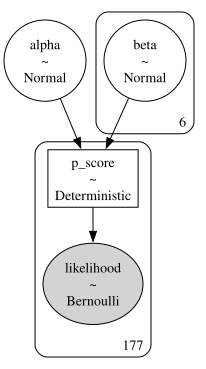

In [22]:
# --- What does our model look like?
pm.model_to_graphviz(SFM)

<br>

================================================ <font color='green'>**TASK 2 -- START**</font> ================================================

<br>

Draw from the posterior distribution:
- number of samples: &emsp; &emsp; &emsp; &emsp; 10.000
- number of burn-in steps: &ensp; 3.000

In [23]:
# ========================================== Click the Inference Button ================================================= #

with SFM:

    trace = pm.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 2 seconds.



================================================ <font color='green'>**TASK 2 -- End**</font>  =================================================

<br>

**Some Diagnostics of our Sampling**

Even though the sampling may not have triggered any warnings, let's have a closer look by inspecting the trace itself.
When running the following cell, the picture on the right-hand-side should look something like the following:

<br>

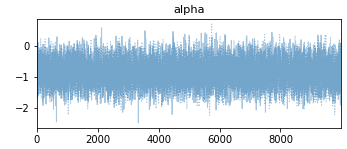



<br>

================================================ <font color='green'>**TASK 3 -- START**</font> ================================================

<br>

Plot the trace of the Markov chain.

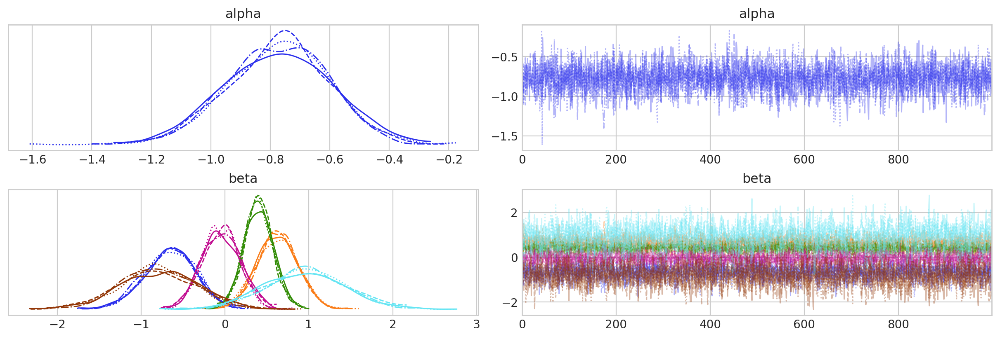

In [24]:
# ========================================== Diagnostics ================================================= #
with SFM:

    traceplot = az.plot_trace(trace, var_names="~p_score")

================================================ <font color='green'>**TASK 3 -- END**</font> =================================================

<br>

Let's inspect the posterior distribiution of our main parameter of interest -- the (estimated) skill/ability ( $\hat{\alpha}_i$ ) of our player of interest -- a bit more closely:


Of course, the loadings on the team statistics ( $\hat{\beta}$ ) might not be any less interesting!

<br>

================================================ <font color='green'>**TASK 4 -- START**</font> ================================================

<br>

Plot the posterior distribution for $\alpha_i$.

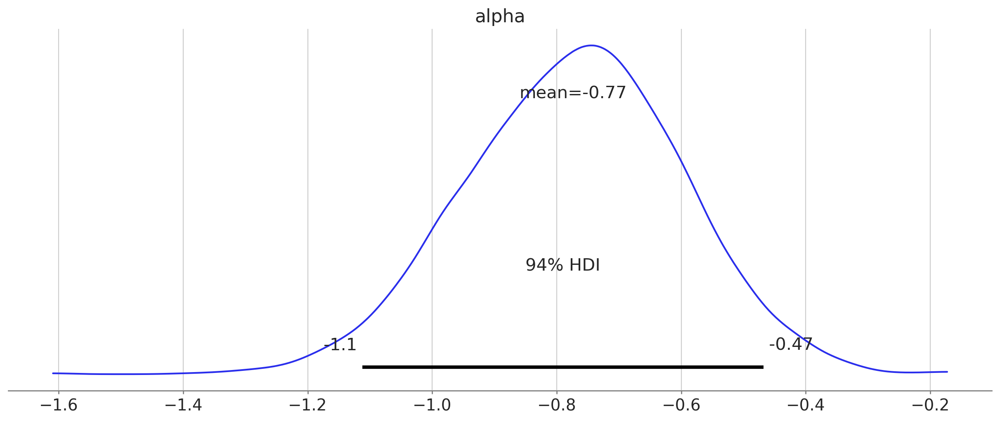

In [25]:
# ========================================== Diagnostics: Plot Posterior ================================================= #

with SFM:

    az.plot_posterior(trace, var_names=["alpha"])

================================================ <font color='green'>**TASK 4 -- END**</font> =================================================

<br>


So far so good. But now let's do what we are here for and answer our main research question:

<br>


<center><font color='gold' size=4.5>" What is the probability of a player scoring, based only on his Skill/Ability? "</font></center>

<br>

Said differently, what is a player's probability of scoring if all teams were equally strong (or weak)?

<br>

Here we'll go on a liitle detour. Note that instead of using the $\mathtt{sigmoid}$ function, we can rewrite Equation $\left( 1 \right)$ in form of the log-odds-ratio:

<br>

\begin{align}
     log\left(\frac{\hat{p}_{i}}{1-\hat{p}_{i}}\right) = \hat{\alpha}_i + \mathbf{X}_{i} \, \mathbf{\hat{\beta}}
\end{align}

where the little hat above our parameters $\left( \hat{} \right)$ just indicates that these are *estimates* of the *true parameters* that we draw from the joint-posterior distribution (`trace.posterior`).

<br>

We now conduct the following steps to answer our research-question stated above:

> 1. By assuming that *all teams are equally strong*, we set all our "factors" ($\mathbf{X}_{i}$) to 0, such that our model reduces to:

$$log\left(\frac{\hat{p}_{i}}{1-\hat{p}_{i}}\right) = \hat{\alpha}_{i}$$

> 2. Then, we get the probability $\hat{p}_{i}$ by rearranging:

$$\hat{p}_{i} = \frac{e^{\hat{\alpha}_{i}}}{1+e^{\hat{\alpha}_{i}}}$$


> 3. Which value to choose for $\hat{\alpha}_{i}$? The *mean* or the *median*?
I mostly go with the *median*, but feel free to play around.

================================================ <font color='green'>**TASK 5 -- START**</font> ================================================

<br>

Let's get our estimate for $\hat{\alpha}_i$ :

- calculate the mean
- calculate the median

In [26]:
# --- Let's choose the mean
alpha_mean = np.mean(trace.posterior["alpha"].values)
print("Mean Skill (\u03B1\u1d62): ", np.round(alpha_mean, 2))

# --- Or the median
alpha_median = np.median(trace.posterior["alpha"].values)
print("Median Skill (\u03B1\u1d62): ", np.round(alpha_median, 2))

Mean Skill (αᵢ):  -0.77
Median Skill (αᵢ):  -0.77


================================================ <font color='green'>**TASK 5 -- END**</font> =================================================


================================================ <font color='green'>**TASK 6 -- START**</font> ================================================

<br>

Take either the *mean* or the *median* of $\hat{\alpha}_i$, and transform it into $\hat{p}_i$ using:

$$\hat{p}_{i} = \frac{e^{\hat{\alpha}_{i}}}{1+e^{\hat{\alpha}_{i}}}$$

In [27]:
# =================================== Define a Helper-Function =================================== #


def sigmoid_activation(x):

    return np.exp(x) / (1 + np.exp(x))

In [28]:
# ---- Probability of Scoring, conditioning on Skill/Ability only (choose either 'alpha_mean' or 'alpha_median'):
prob = sigmoid_activation(alpha_mean)

print("Probability of Scoring (only based on Skill): ", np.round(prob, 2))

Probability of Scoring (only based on Skill):  0.32


================================================ <font color='green'>**TASK 6 -- END**</font> =================================================

<br>

================================================ <font color='green'>**TASK 7 -- START**</font> ================================================

<br>

**Let's define the Uncertainty around our Point Prediction**

That is, define the boundaries $\left[\hat{p}^{low}_{i},\hat{p}^{up}_{i}\right]$ of the interval, within which our point-estimate $\hat{p}_{i}$ ranges with `cred_region` % of certainty.

In [32]:
# ---- Let's define the Uncertainity:
cred_region = 0.95

# --- --- Get the "alpha" value at the lower- and upper-bounds
alpha_post_up = np.quantile(
    trace.posterior["alpha"].values, q=1 - (1 - cred_region) / 2
)
alpha_post_low = np.quantile(trace.posterior["alpha"].values, q=(1 - cred_region) / 2)

# --- --- Convert to Probabilities
prob_up = sigmoid_activation(alpha_post_up)
prob_low = sigmoid_activation(alpha_post_low)

print("Credible Region: ", cred_region * 100, "% \n")
print(
    "Probability of Scoring (only based on Skill) -- Lower Bound: ",
    np.round(prob_low, 2),
)
print(
    "Probability of Scoring (only based on Skill) -- Upper Bound: ",
    np.round(prob_up, 2),
)

Credible Region:  95.0 % 

Probability of Scoring (only based on Skill) -- Lower Bound:  0.25
Probability of Scoring (only based on Skill) -- Upper Bound:  0.39


================================================ <font color='green'>**TASK 7 -- END**</font> =================================================

<br>

Well ... interesting ...

...<font size="4">**but is our model actually any good, or just producing complete crap?**</font>

That is, let's have a look at what our model tells us about the probability of player $i$ scoring a goal ($\hat{Y}_i$), and how well these *in-sample* predictions match the observed occurrences ($Y_i$).

<br><br>

In order to get $\hat{Y}$, we'll draw samples from the **Posterior Predictive Distribution**.
That is, we compute a Bernoulli distribution based on samples of our posterior estimates for the probability of player $i$ scoring ($\hat{p}_i$), which we extract from `trace.posterior["p_score"]`.
What we get in return is a **binary** vector $\hat{Y}$ made up of $0$ and $1$.

<br><br>

Then we can evaluate how well our model's predictions for a player scoring ($\hat{Y}_i = 1$) or not ($\hat{Y}_i = 0$) match our empricially observed data ($Y_i$). Some of the frequently used *evaluation metrics* to do that are:

> - Mean-Squared Error (MSE): &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; the classical metric for regression-models;
> - Log-Probability Loss (Log-Prob): &emsp;&emsp;&emsp; since we're dealing with a classification exercise;
> - Area Under the Curve (AUC): &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; maybe the most common metric for classification exercises;

<br>

I feel most comfortable to judge the model by looking at the AUC (often also called AUROC (Area Under the Receiver-Operating-Cost Curve)). The AUC tells us pretty neatly, whether our model actually adds some value to predict player $i$'s probability to score in the upcoming match.

> $AUC_i = 0.5$: &ensp;&ensp; we can be pretty confident that our model is no good and we could have just tossed a coin instead.

> $AUC_i = 1$: &ensp;&ensp;&ensp;&emsp; we've pretty much nailed it! Not only does our model accurately predict whether <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; player $i$ scores in the upcoming match or not, but we have also done an awesome job in specifying our model <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; (read: which team-factors to include and which not) !

<br>

<font color='darkred'>**DISCLAIMER**</font>: &emsp; When I say "*accurately predict*", beware that this is en entirely *in-sample* (explanatory) analysis. The model may <br> &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; potentially radically overfit, and then produce complete non-sense in an out-of-sample exercise, i.e. on data it has not yet seen.

<br>

While this is a big concern, making out-of-sample predictions is not what this whole exercise had been intended to produce.
That's why I'll save the testing of the model's out-of-sample performance for the future...


<br><br>

Enough rambling, let's move on to the evaluation...

<br>

================================================ <font color='green'>**TASK 8 -- START**</font> ================================================

<br>

In order to evaluate your model's predictive ability, calculate the following metrics:

- Root-Mean-Squared-Error (RMSE), i.e. in classification exercises also called the *Brier Score*

- Log-Probability-Score (Log-Prob)

- Area Under the (Receiver Operating Cost) Curve (AUC)

In [ ]:
# =================================== Define Some Helper-Functions =================================== #


def func_rmse(y_true, y_hat):

    return (np.sum((y_true - y_hat) ** 2) / len(y_true)) ** 0.5


def func_logprob(y_true, y_hat):

    return -sum(
        (1 - y_true) * np.log(np.maximum(1 - y_hat, 1e-5))
        + y_true * np.log(np.maximum(y_hat, 1e-5))
    ) / len(y_hat)

In [33]:
trace.posterior

<xarray.Dataset> Size: 6MB
Dimensions:        (chain: 4, draw: 1000, beta_dim_0: 6, p_score_dim_0: 177)
Coordinates:
  * chain          (chain) int64 32B 0 1 2 3
  * draw           (draw) int64 8kB 0 1 2 3 4 5 6 ... 994 995 996 997 998 999
  * beta_dim_0     (beta_dim_0) int64 48B 0 1 2 3 4 5
  * p_score_dim_0  (p_score_dim_0) int64 1kB 0 1 2 3 4 5 ... 172 173 174 175 176
Data variables:
    alpha          (chain, draw) float64 32kB -0.7944 -0.8136 ... -0.9703
    beta           (chain, draw, beta_dim_0) float64 192kB -0.5533 ... 0.9278
    p_score        (chain, draw, p_score_dim_0) float64 6MB 0.2684 ... 0.2667
Attributes:
    created_at:                 2024-05-01T20:36:23.157616+00:00
    arviz_version:              0.18.0
    inference_library:          pymc
    inference_library_version:  5.13.1
    sampling_time:              1.6896491050720215
    tuning_steps:               1000

In [34]:
data_single

,goal,goals_in_match,points_team,points_opp,goalsscored_cum_team,goalsscored_cum_opp,goalsconceded_cum_team,goalsconceded_cum_opp,home_pitch,goalsscored_rank_team,...,kickoff_dt,goalsscored_rank_opp,goalsconceded_rank_team,goalsscored_diff,goal_balance_team,goal_balance_opp,goal_balance_diff,points_diff,goalsscored_share_player_team,name_player
0,0.0,0.0,12.0,13.0,9.0,11.0,2.0,3.0,1.0,7.0,...,2003-09-21 16:05:00,4.0,7.0,-2.0,7.0,8.0,-1.0,-1.0,0.000000,cristiano ronaldo
1,0.0,0.0,19.0,8.0,16.0,8.0,3.0,17.0,0.0,2.0,...,2003-10-18 12:00:00,14.0,2.0,8.0,13.0,-9.0,22.0,11.0,0.000000,cristiano ronaldo
2,0.0,0.0,22.0,15.0,17.0,17.0,3.0,12.0,1.0,4.0,...,2003-10-25 00:00:00,4.0,4.0,0.0,14.0,5.0,9.0,7.0,0.000000,cristiano ronaldo
3,1.0,1.0,22.0,12.0,18.0,11.0,6.0,12.0,1.0,4.0,...,2003-11-01 00:00:00,11.0,4.0,7.0,12.0,-1.0,13.0,10.0,0.000000,cristiano ronaldo
4,0.0,0.0,28.0,11.0,23.0,17.0,7.0,22.0,1.0,2.0,...,2003-11-22 00:00:00,9.0,3.0,6.0,16.0,-5.0,21.0,17.0,0.043478,cristiano ronaldo
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
172,1.0,2.0,74.0,44.0,56.0,39.0,21.0,36.0,1.0,2.0,...,2009-04-25 17:30:00,8.0,6.0,17.0,35.0,3.0,32.0,30.0,0.267857,cristiano ronaldo
173,0.0,0.0,77.0,31.0,61.0,25.0,23.0,49.0,0.0,1.0,...,2009-05-02 12:45:00,19.0,6.0,36.0,38.0,-24.0,62.0,46.0,0.278689,cristiano ronaldo
174,1.0,1.0,80.0,47.0,63.0,56.0,23.0,46.0,1.0,2.0,...,2009-05-10 13:30:00,4.0,6.0,7.0,40.0,10.0,30.0,33.0,0.269841,cristiano ronaldo
175,0.0,0.0,83.0,42.0,65.0,32.0,23.0,41.0,0.0,1.0,...,2009-05-13 20:00:00,17.0,6.0,33.0,42.0,-9.0,51.0,41.0,0.276923,cristiano ronaldo


In [ ]:
# =================================== Get predictive samples =================================== #

pred_samples = trace.posterior["p_score"].values

# --- Calculate the Mean
mean = np.mean(pred_samples, axis=(0, 1)).flatten()

print("Player: " + my_player_single)
print("\n")
print("RMSE:     ", np.round(func_rmse(y_true=Y_train, y_hat=mean), 4))
print("Log-Prob: ", np.round(func_logprob(y_true=Y_train, y_hat=mean), 4))
print("AUC:      ", np.round(roc_auc_score(y_true=Y_train, y_score=mean), 4))

Player: cristiano ronaldo


RMSE:      0.4398
Log-Prob:  0.573
AUC:       0.7106


================================================ <font color='green'>**TASK 8 -- END**</font> =================================================

<br><br>
Hopefully we got an $AUC$ north of at least  $0.65$ -- or even better  $0.70$ (let's not shoot for the moon and hope to get something like $0.85$). Otherwise we should probably think about adjusting our model in terms of which "factors" to in- and exclude.


<br>

**Final Exercise: Time-Series Plot!**

Let's look at the player's probability of scoring -- based on the full model -- over time. The shaded areas are the matches in which the player has scored a goal.

<ipython-input-77-05829cbce10a>:28: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(x_label)


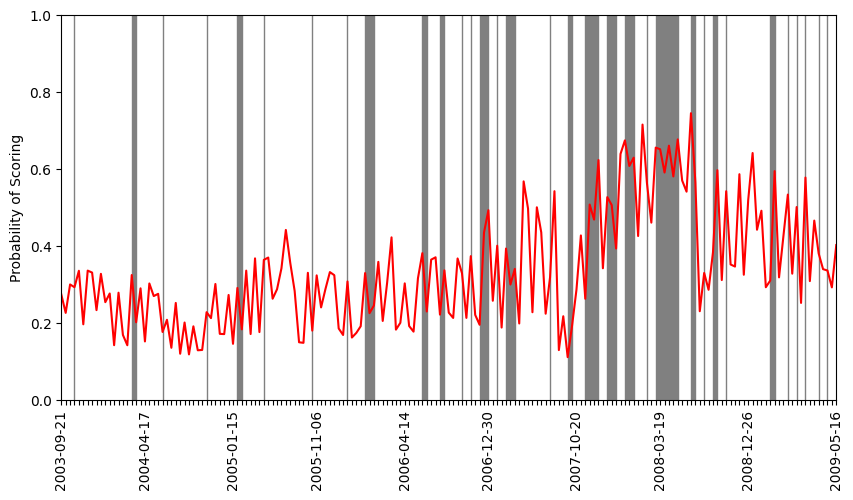

In [ ]:
# ======================== Let's look at the Time-Series of our estimated probabilities (where: P(Y=1|alpha + X' beta)) =================== #

timesteps = data_single.kickoff_dt

# --- Pick 10 labels for the x-axis
x_label = np.repeat("", len(timesteps)).astype("<U10")
for ll in np.linspace(0, len(x_label) - 1, 10, dtype=int):
    x_label[ll] = timesteps[ll][0:10]


# --- Initialize the plot
fig, ax = plt.subplots(1, 1, figsize=(10, 5))

# --- Shade the Matches with Goals
ax.fill_between(
    data_single.kickoff_dt,
    0,
    1,
    where=data_single["goal"],
    transform=ax.get_xaxis_transform(),
    color="gray",
)

# --- Plot the mean
plt.plot(timesteps, mean, color="red", label="Mean Scoring Probability")


# ---- Some cosmetics
plt.xlim([timesteps[0], timesteps[len(timesteps) - 1]])
plt.ylim([0, 1])
plt.ylabel("Probability of Scoring")
ax.set_xticklabels(x_label)
ax.tick_params(axis="x", rotation=90)

# ---- Show the plot
plt.show()

<br>
<br>
<br>

### <font size="5" color="red">**2.2 &emsp; Multiple Players**</font>

<br>

*Question*: &emsp;&emsp; Why look at multiple players?

*Answer*: &emsp;&emsp;&emsp;&emsp; We will *pool* the observations of several players, which will give us *more* training-data, <br> &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; which in turn shall improve the precision of our parameter estimates.

<br>

The following cell allows you to specify

> - `my_vars`: &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; The list of features $\mathbf{X}$ . You can -- in theory -- choose any variable from `data.columns`.
> - `I_want_stand`: &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; The option to standardize the data.

In [5]:
# ================================== USER INTERACTION ============================== #

# --- Define your explanatory variables [column names of 'data']:
my_vars = [
    "goalsscored_rank_team",
    "goalsscored_rank_team_wo_player",
    "home_pitch",
    "goalsconceded_rank_opp",
    "points_diff",
    "goal_balance_diff",
]

# --- Do you want to standardize your data?
I_want_stand = True

# ================================== USER INTERACTION ============================== #

In [36]:
# ================================== Define your Y and X ============================== #

# --- Get your X and Y
X_train = np.array(data[my_vars]).astype(float)
Y_train = np.array(data["goal"])


# --- Before moving on: do you want to standardize the features?
if I_want_stand == True:

    X_train_true = X_train.copy()

    # --- --- Mean & SD of 'data'
    X_mean = np.mean(X_train_true, axis=0)
    X_sd = np.std(X_train_true, axis=0)

    # ---- --- Standardize 'data'
    X_train = (X_train_true - X_mean) / X_sd

<font size='4'>**How does our model in Equation $\left( 1 \right)$ change?**</font>

<br>

With multiple players in our training set, i.e. with a dataset that is a pooled cross-section of indviduals, we have a few more modeling options available to us.
The intention is of course that these choices will give us more precise estimates of our paramters (i.e. reduce sharpen the posterior distribution of our parameters).

<br>

Given an altered data-structure compared to the <font color="green">single-player</font> model, I will incorporate the following assumptions into the <font color="red">multiple-player</font> model:

> <font color='blue'>Assumption 1</font>: &emsp; If the goal-scoring probability of player $i$ shows a different sensitivity to the *factors* than player $j$ does, then this <br> &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; should be a sign of *adaptivity* of a given player. This should then not be reflected in $\beta_i$, but in our skill/ability <br> &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; parameter $\alpha_i$. Hence, there won't be any player-specific *factor*-loadings, $\beta_i \;$! <br> &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; Our  $\beta$-vector of *factor*-loadings will be *common* across all players!

<br>

> <font color='blue'>Assumption 2</font>: &emsp; What if our players got better (or worse) over time (i.e. let's allow for "seasonal" skill) ?!

<br>

Thus, we have:

- **individual** skill-/ability-coefficient, that **varies by season**: $\alpha_{i,s}$

- **common** loadings on team-statistics: $\beta$

<br>
<br>

**Model**:


\begin{align}
     p_{i,s} \equiv   P\left(Y_{i,s} = 1 | \mathbf{X}_{i,s}, \alpha_{i,s}, \beta \right) = \sigma \left(\alpha_{i,s} + \mathbf{X}_{i,s} \, \mathbf{\beta} \right) \qquad \left( 2 \right )
\end{align}

<br>

<font color="darkred">**NOTE**</font>: &emsp; Since our skill/ability parameter ($\alpha_{i,s,}$) now carries a subscript $s$, I have also attached it <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp; to our observed outcome variable ($Y_{i,s}$), and our *factors* ($\mathbf{X}_{i,s}$) .

<br>

================================================ <font color='green'>**TASK 1 -- START**</font> ================================================

<br>

Now, using Equation $\left(2\right)$ above, set up the model by thinking about:


- which distributions are appropriate as priors for the parameters $\left(\alpha_{i,s}, \beta\right)$ in our model?
- which distribution best describes the target variable $\mathbf{Y}_{i,s}$?

<br>

<font color='red'>**NOTE**</font>: Again, the model container below gives you some hints, but don't feel obliged to follow the exact same structure. I will not set any hyperpriors, but feel free to play around and be creative.

In [48]:
# --- Create a 'player_season' indicator
data["player_season"] = data["name_player"] + [" "] + data["season"]

# --- Get your Players' indices --> Now differentiated by Season!
player_idxs, players = pd.factorize(data.player_season)

coords = {"players": players, "obs_id": np.arange(len(player_idxs))}

In [53]:
with pm.Model(coords=coords) as SFM_multi:

    # --- We want to allow for the possibility of player-specific Skill-/Ability-Parameters
    player_idx = pm.ConstantData("player_idx", player_idxs, dims="obs_id")

    # --- Set your priors:

    # --- "\alpha", i.e. the parameter that will give us the Player's ability
    alpha = pm.Normal("alpha", mu=0, sigma=1, dims="players")

    # --- "\beta(s)": the features are designed such that higher/more positive values,
    #     should INCREASE the likelihood of the player scoring ---> i.e. this "decreases" 'alpha'
    #     ---> Option 1:  model "\beta(s)" to be positive numbers
    #     ---> Option 2:  let's be agnostic and allow for negative values as well
    beta = pm.Normal("beta", mu=0, sigma=1, shape=len(my_vars))

    # --- Probability of Scoring:
    p_score = pm.Deterministic(
        "p_score", pm.math.sigmoid(alpha[player_idx] + pm.math.dot(X_train, beta))
    )

    # --- Fit the Data:
    likelihood = pm.Bernoulli("likelihood", p_score, observed=Y_train, dims="obs_id")

### Poisson Model

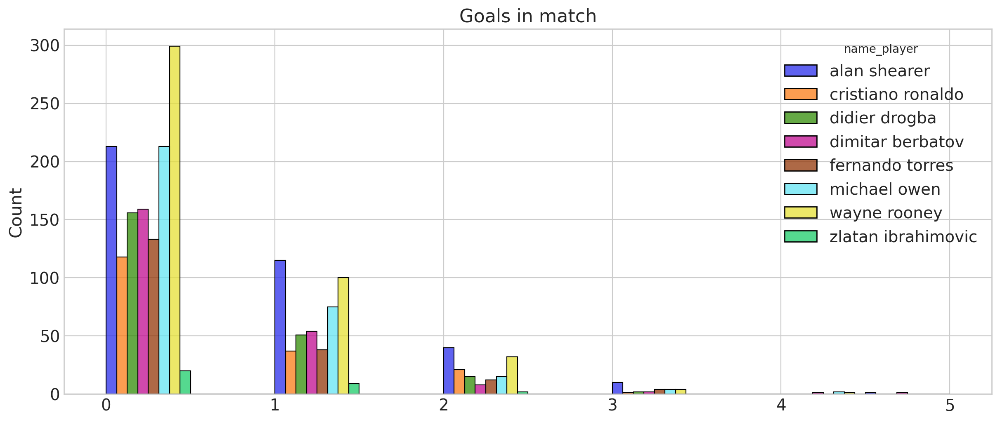

In [373]:
ax = sns.histplot(
    data, x="goals_in_match", hue="name_player", multiple="dodge", binwidth=0.5
)
ax.set(title="Goals in match", xlabel="");

In [88]:
data["kickoff_dt"] = pd.to_datetime(data["kickoff_dt"], yearfirst=True)

# compute season number for each player, ~maturity of player
data["season_nbr"] = data.groupby(["name_player"])["season"].transform(
    lambda x: x.factorize(sort=True)[0]
)

# compute days since first game of the season for each player
# aka within-season effects
data["days_since_first_game"] = data.groupby(["name_player", "season"])[
    "kickoff_dt"
].transform(lambda x: (x - x.min()).dt.days)

data["goals_in_match"] = data["goals_in_match"].astype(int)

data = data.sort_values(["name_player", "kickoff_dt"]).reset_index(drop=True)

In [108]:
(data.groupby(["name_player"])["season_nbr"].max() + 1).sort_values()

name_player
zlatan ibrahimovic     2
cristiano ronaldo      6
fernando torres        7
dimitar berbatov       8
didier drogba          9
alan shearer          14
michael owen          16
wayne rooney          16
Name: season_nbr, dtype: int64

In [120]:
# just to check our season nbrs are right
data.groupby(["name_player"])["season"].nunique().sort_values()

name_player
zlatan ibrahimovic     2
cristiano ronaldo      6
fernando torres        7
dimitar berbatov       8
didier drogba          9
alan shearer          14
michael owen          16
wayne rooney          16
Name: season, dtype: int64

In [116]:
data.groupby(["name_player", "season"])["days_since_first_game"].max()

name_player         season 
alan shearer        1992/93    112
                    1993/94    247
                    1994/95    238
                    1995/96    214
                    1996/97    239
                              ... 
wayne rooney        2015/16    240
                    2016/17    239
                    2017/18    217
zlatan ibrahimovic  2016/17    204
                    2017/18     37
Name: days_since_first_game, Length: 78, dtype: int64

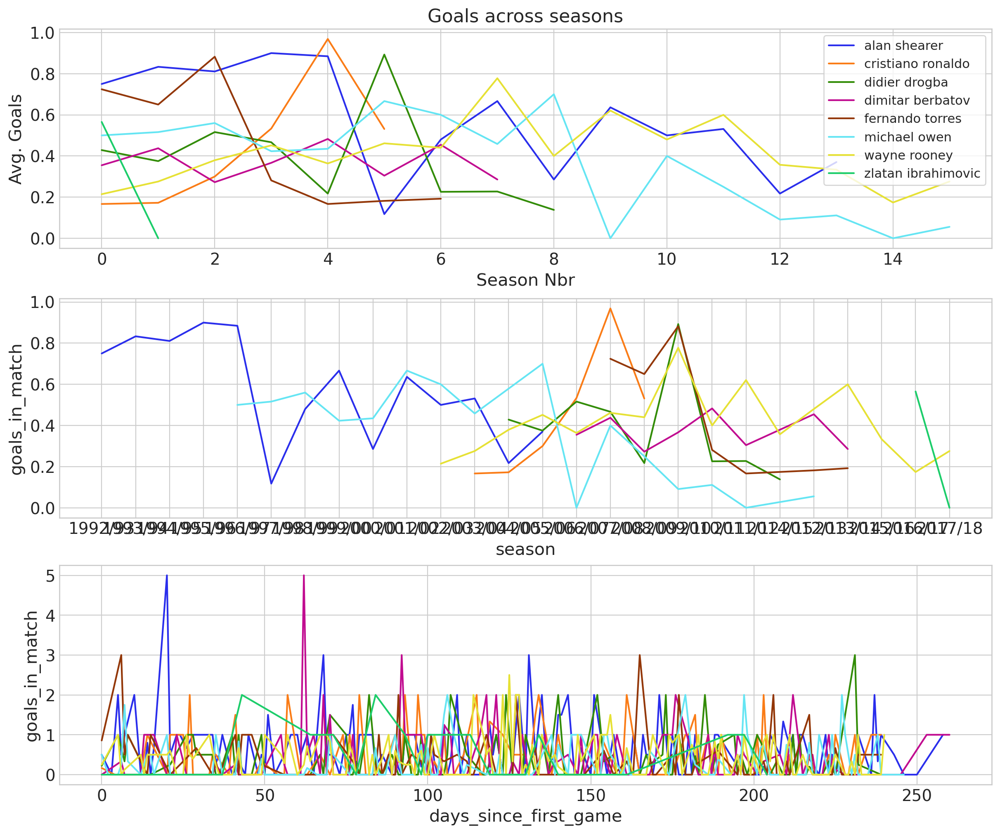

In [375]:
_, axes = plt.subplots(3, 1, figsize=(12, 10))

sns.lineplot(
    data,
    x="season_nbr",
    y="goals_in_match",
    hue="name_player",
    errorbar=None,
    ax=axes[0],
)
axes[0].set(title="Goals across seasons", ylabel="Avg. Goals", xlabel="Season Nbr")
axes[0].legend(frameon=True, fontsize=11)

sns.lineplot(
    data,
    x="season",
    y="goals_in_match",
    hue="name_player",
    errorbar=None,
    ax=axes[1],
    legend=False,
)
sns.lineplot(
    data,
    x="days_since_first_game",
    y="goals_in_match",
    hue="name_player",
    errorbar=None,
    ax=axes[2],
    legend=False,
);

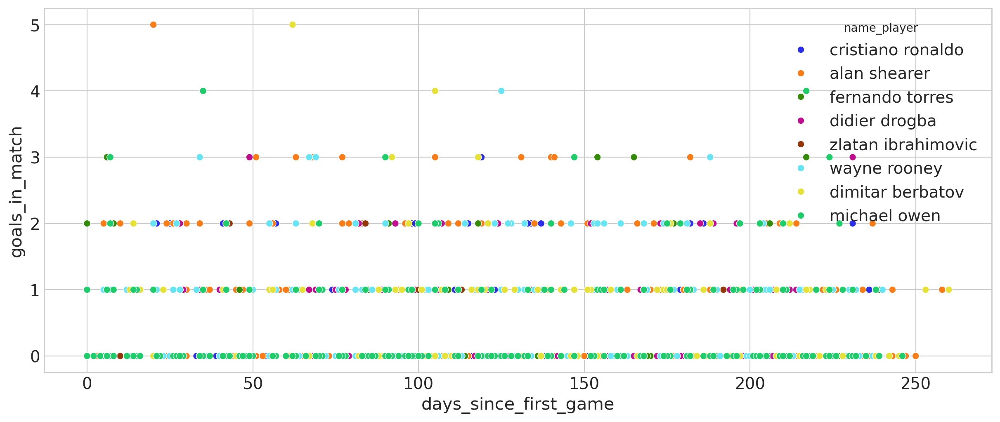

In [126]:
sns.scatterplot(data, x="days_since_first_game", y="goals_in_match", hue="name_player");

In [133]:
if I_want_stand == True:

    factors_train = data[my_vars].astype(float)
    days_train = data["days_since_first_game"]

    # --- --- Mean & SD of 'data'
    factors_mean = factors_train.mean(axis=0)
    factors_sd = factors_train.std(axis=0)

    days_mean = data["days_since_first_game"].mean()
    days_std = data["days_since_first_game"].std()

    # ---- --- Standardize 'data'
    factors_sdz = (factors_train - factors_mean) / factors_sd
    days_sdz = (days_train - days_mean) / days_std

In [141]:
player_idx, players = pd.factorize(data.name_player)
coords = {"player": players, "factor": my_vars, "obs_id": data.index}

In [147]:
with pm.Model(coords=coords) as SFM_poisson:

    # Data containers
    seasons = pm.Data("seasons", data["season_nbr"].to_numpy(), dims="obs_id")
    days = pm.Data("days", days_sdz.to_numpy(), dims="obs_id")
    player_id = pm.Data("player_id", player_idx, dims="obs_id")
    factor_data = pm.Data(
        "factor_data", factors_sdz.to_numpy(), dims=("obs_id", "factor")
    )
    goals_obs = pm.Data("goals_obs", data["goals_in_match"].to_numpy(), dims="obs_id")

    # player skills
    baseline = pm.Normal("baseline", mu=0, sigma=1, dims="player")
    maturity_effect = pm.Normal("maturity_effect", mu=0, sigma=0.5, dims="player")
    within_season_effect = pm.Normal(
        "within_season_effect", mu=0, sigma=0.5, dims="player"
    )
    alpha = pm.Deterministic(
        "alpha",
        baseline[player_id]
        + maturity_effect[player_id] * seasons
        + within_season_effect[player_id] * days,
        dims="obs_id",
    )

    # team factors
    beta = pm.Normal("beta", mu=0, sigma=0.5, dims="factor")

    # --- Probability of Scoring:
    scoring_rate = pm.Deterministic(
        "scoring_rate",
        pt.softplus(alpha + pm.math.dot(factor_data, beta)),
        dims="obs_id",
    )

    pm.Poisson("goals_scored", scoring_rate, observed=goals_obs, dims="obs_id")

    idata = pm.sample_prior_predictive()

Sampling: [baseline, beta, goals_scored, maturity_effect, within_season_effect]


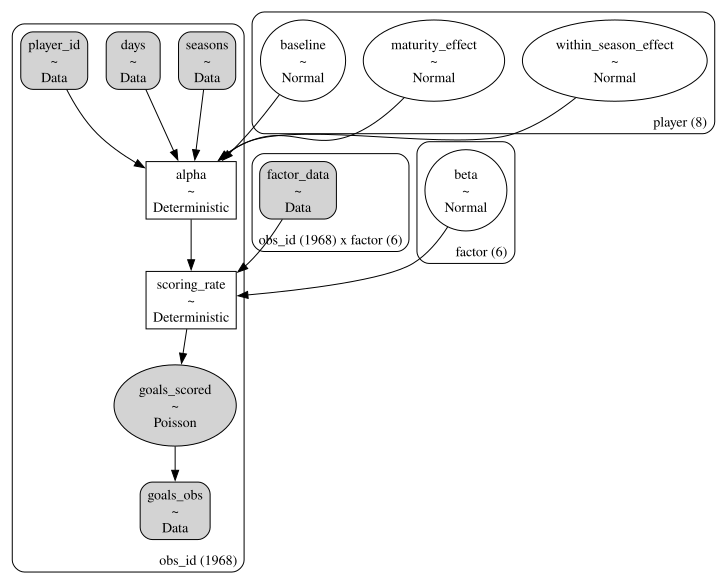

In [148]:
pm.model_to_graphviz(SFM_poisson)

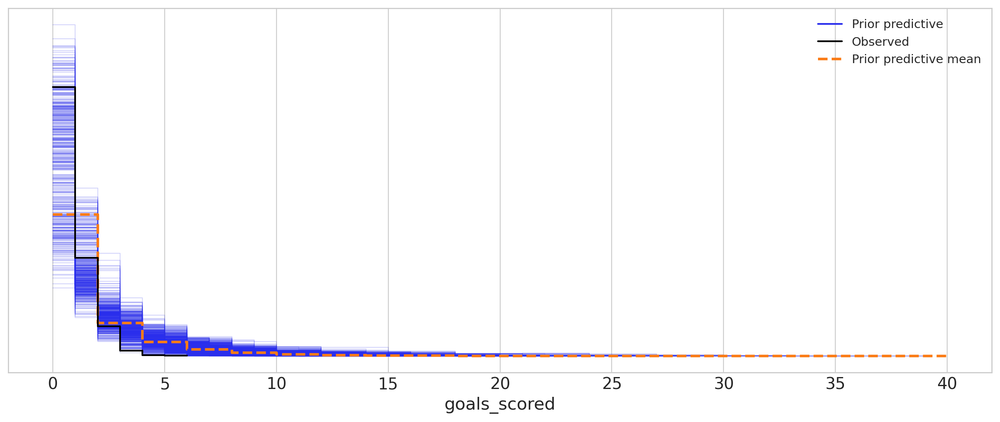

In [150]:
az.plot_ppc(idata, group="prior", observed=True);

In [151]:
with SFM_poisson:
    idata.extend(pm.sample())
    idata.extend(pm.sample_posterior_predictive(idata))

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [baseline, maturity_effect, within_season_effect, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 9 seconds.
Sampling: [goals_scored]


Output()

In [154]:
az.summary(idata, var_names=["~alpha", "~scoring_rate"], round_to=2)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline[alan shearer],0.05,0.20,-0.32,0.44,0.00,0.00,2664.87,2991.79,1.0
baseline[cristiano ronaldo],-1.45,0.31,-2.01,-0.85,0.01,0.00,3528.54,2226.64,1.0
baseline[didier drogba],-0.48,0.24,-0.92,-0.04,0.00,0.00,4002.65,3029.31,1.0
baseline[dimitar berbatov],-0.76,0.23,-1.18,-0.31,0.00,0.00,3791.85,3002.96,1.0
baseline[fernando torres],0.08,0.24,-0.37,0.51,0.00,0.00,4465.46,3247.84,1.0
baseline[michael owen],0.02,0.21,-0.35,0.41,0.00,0.00,3676.23,3099.05,1.0
baseline[wayne rooney],-0.69,0.18,-1.02,-0.36,0.00,0.00,3617.30,2987.09,1.0
baseline[zlatan ibrahimovic],-0.57,0.37,-1.24,0.13,0.00,0.00,6325.58,3224.79,1.0
beta[goalsscored_rank_team],-0.05,0.08,-0.20,0.10,0.00,0.00,2909.59,3001.82,1.0
beta[goalsscored_rank_team_wo_player],0.18,0.09,0.00,0.35,0.00,0.00,2514.77,2736.04,1.0


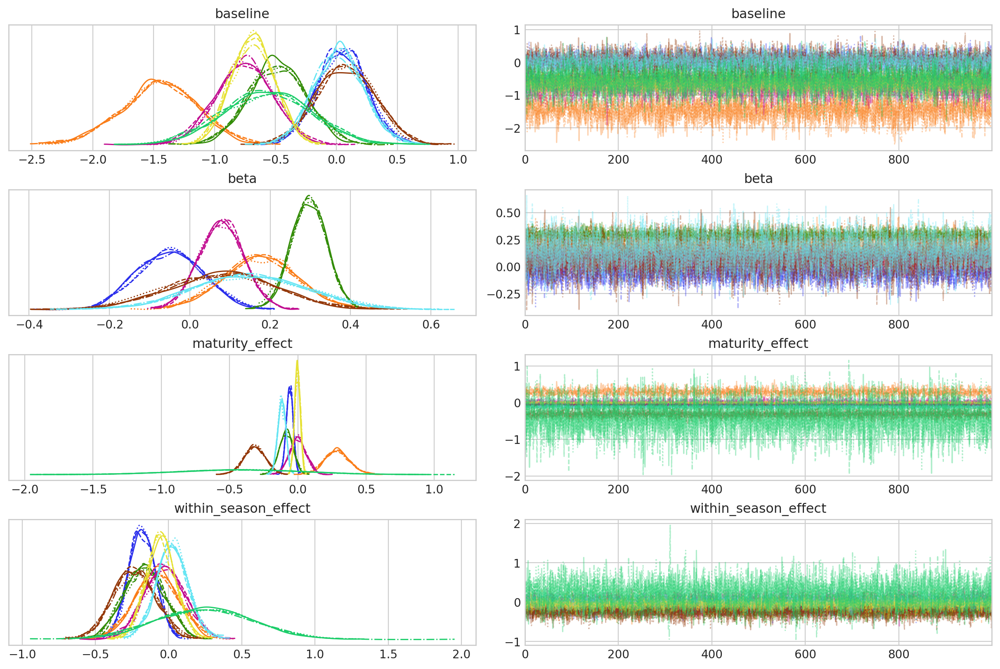

In [161]:
az.plot_trace(idata, var_names=["~alpha", "~scoring_rate"]);

In [162]:
az.plot_rank(idata, var_names=["~alpha", "~scoring_rate"]);

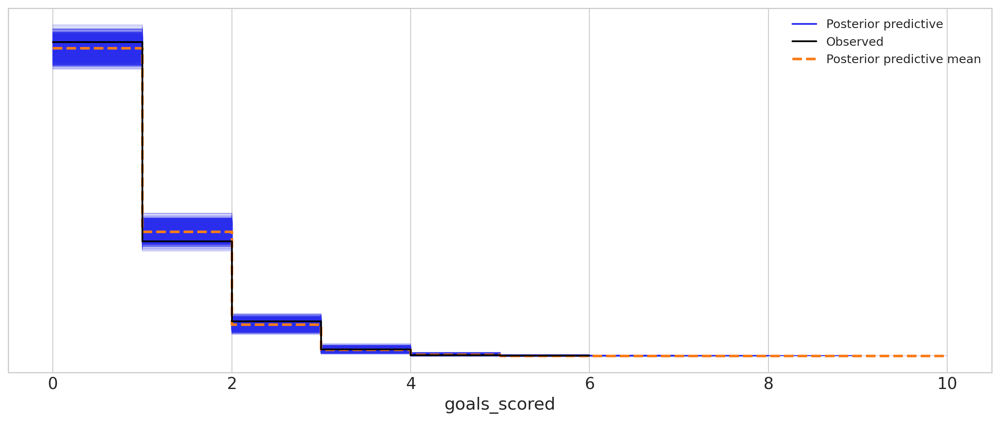

In [169]:
az.plot_ppc(idata);

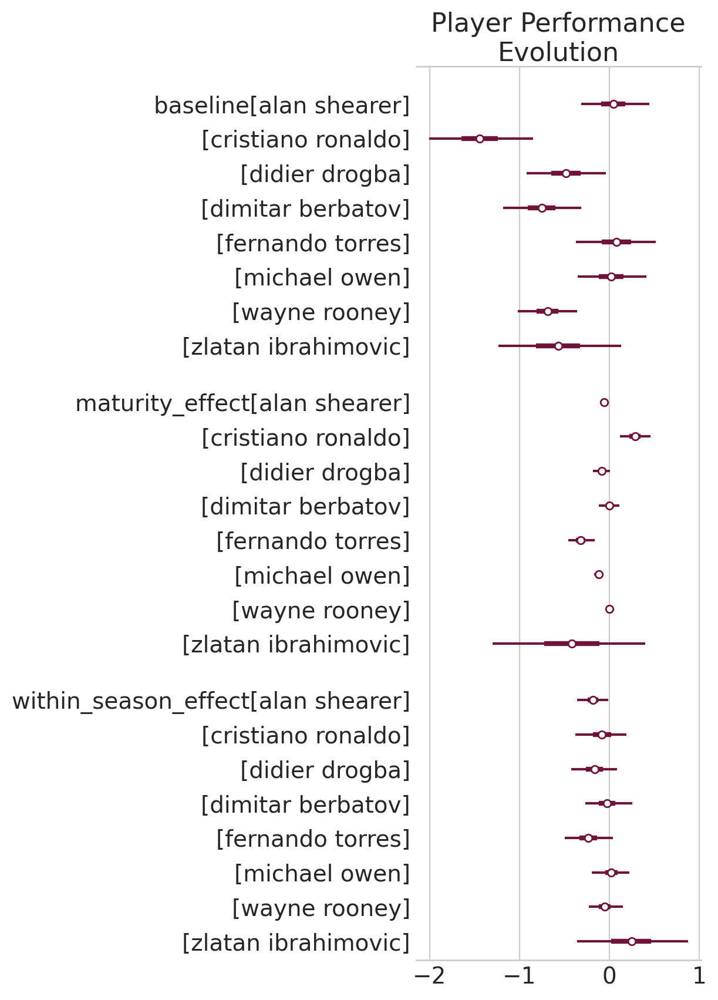

In [378]:
ax = az.plot_forest(
    idata,
    var_names=["baseline", "maturity_effect", "within_season_effect"],
    combined=True,
    colors="#70133A",
)
ax[0].set_title("Player Performance Evolution");

In [186]:
index = pd.MultiIndex.from_product(
    [players, data["season_nbr"].unique()], names=["player", "season_nbr"]
)
unique_combinations = pd.DataFrame(index=index).reset_index()

unique_combinations_start = unique_combinations.copy()
unique_combinations_mid = unique_combinations.copy()
unique_combinations_end = unique_combinations.copy()

(
    unique_combinations_start["days_sdz"],
    unique_combinations_mid["days_sdz"],
    unique_combinations_end["days_sdz"],
) = (days_sdz.min(), days_sdz.mean(), days_sdz.max())

In [259]:
with SFM_poisson:
    pm.set_data(
        coords={"obs_id": unique_combinations_start.index},
        new_data={
            "seasons": unique_combinations_start["season_nbr"],
            "days": unique_combinations_start["days_sdz"],
            "player_id": pd.Categorical(
                unique_combinations_start["player"], categories=players
            ).codes,
            "factor_data": np.zeros(
                (len(unique_combinations_start), len(my_vars))
            ),  # all teams are equal
            "goals_obs": np.zeros(
                len(unique_combinations_start), dtype=int
            ),  # just a placeholder for shape inference
        },
    )

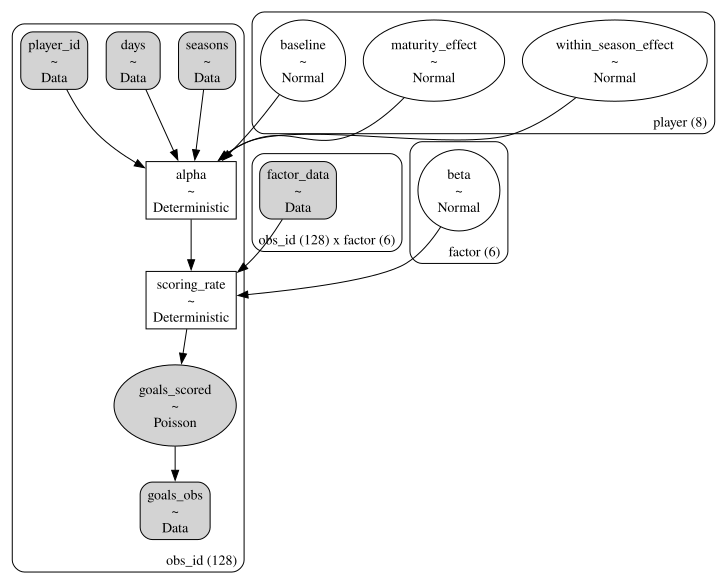

In [260]:
pm.model_to_graphviz(SFM_poisson)

In [261]:
with SFM_poisson:
    preds_start = pm.sample_posterior_predictive(
        idata, var_names=["alpha", "scoring_rate", "goals_scored"], predictions=True
    )

Sampling: [goals_scored]


Output()

In [262]:
with SFM_poisson:
    pm.set_data(
        coords={"obs_id": unique_combinations_mid.index},
        new_data={
            "seasons": unique_combinations_mid["season_nbr"],
            "days": unique_combinations_mid["days_sdz"],
            "player_id": pd.Categorical(
                unique_combinations_mid["player"], categories=players
            ).codes,
            "factor_data": np.zeros(
                (len(unique_combinations_mid), len(my_vars))
            ),  # all teams are equal
            "goals_obs": np.zeros(
                len(unique_combinations_mid), dtype=int
            ),  # just a placeholder for shape inference
        },
    )
    preds_mid = pm.sample_posterior_predictive(
        idata, var_names=["alpha", "scoring_rate", "goals_scored"], predictions=True
    )

    pm.set_data(
        coords={"obs_id": unique_combinations_end.index},
        new_data={
            "seasons": unique_combinations_end["season_nbr"],
            "days": unique_combinations_end["days_sdz"],
            "player_id": pd.Categorical(
                unique_combinations_end["player"], categories=players
            ).codes,
            "factor_data": np.zeros(
                (len(unique_combinations_end), len(my_vars))
            ),  # all teams are equal
            "goals_obs": np.zeros(
                len(unique_combinations_end), dtype=int
            ),  # just a placeholder for shape inference
        },
    )
    preds_end = pm.sample_posterior_predictive(
        idata, var_names=["alpha", "scoring_rate", "goals_scored"], predictions=True
    )

Sampling: [goals_scored]


Output()

Sampling: [goals_scored]


Output()

In [263]:
# declare the Multiindex as coordinates
mindex_coords = xr.Coordinates.from_pandas_multiindex(index, "obs_id")

# pass it as coordinates
preds_start.predictions = preds_start.predictions.assign_coords(mindex_coords)
preds_start.predictions_constant_data = (
    preds_start.predictions_constant_data.assign_coords(mindex_coords)
)
preds_start.predictions

<xarray.Dataset> Size: 12MB
Dimensions:       (chain: 4, draw: 1000, obs_id: 128)
Coordinates:
  * chain         (chain) int64 32B 0 1 2 3
  * draw          (draw) int64 8kB 0 1 2 3 4 5 6 ... 993 994 995 996 997 998 999
  * obs_id        (obs_id) object 1kB MultiIndex
  * player        (obs_id) object 1kB 'alan shearer' ... 'zlatan ibrahimovic'
  * season_nbr    (obs_id) int64 1kB 0 1 2 3 4 5 6 7 8 ... 8 9 10 11 12 13 14 15
Data variables:
    alpha         (chain, draw, obs_id) float64 4MB 0.3294 0.2691 ... -1.852
    goals_scored  (chain, draw, obs_id) int64 4MB 3 2 1 1 0 0 0 ... 0 0 0 0 0 0
    scoring_rate  (chain, draw, obs_id) float64 4MB 0.8714 0.8367 ... 0.1457
Attributes:
    created_at:                 2024-05-03T21:41:56.952531+00:00
    arviz_version:              0.18.0
    inference_library:          pymc
    inference_library_version:  5.13.1

In [265]:
preds_mid.predictions = preds_mid.predictions.assign_coords(mindex_coords)
preds_mid.predictions_constant_data = preds_mid.predictions_constant_data.assign_coords(
    mindex_coords
)

preds_end.predictions = preds_end.predictions.assign_coords(mindex_coords)
preds_end.predictions_constant_data = preds_end.predictions_constant_data.assign_coords(
    mindex_coords
)

In [250]:
n_seasons = data.groupby(["name_player"])["season"].nunique().sort_values()
colors = plt.cm.viridis(np.linspace(0.05, 0.95, 6))

/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_45158/4086814224.py:62: UserWarning: The figure layout has changed to tight
  plt.tight_layout();


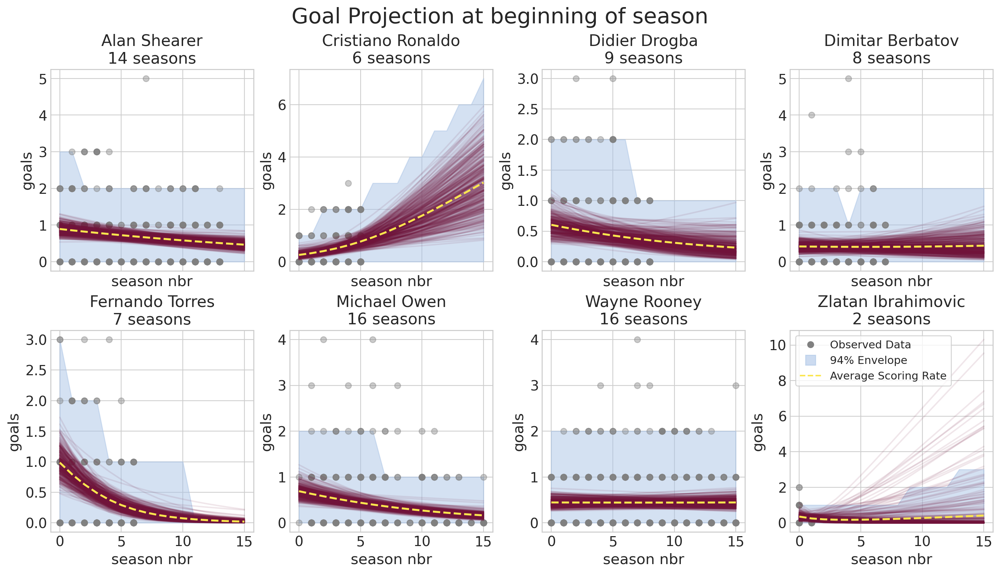

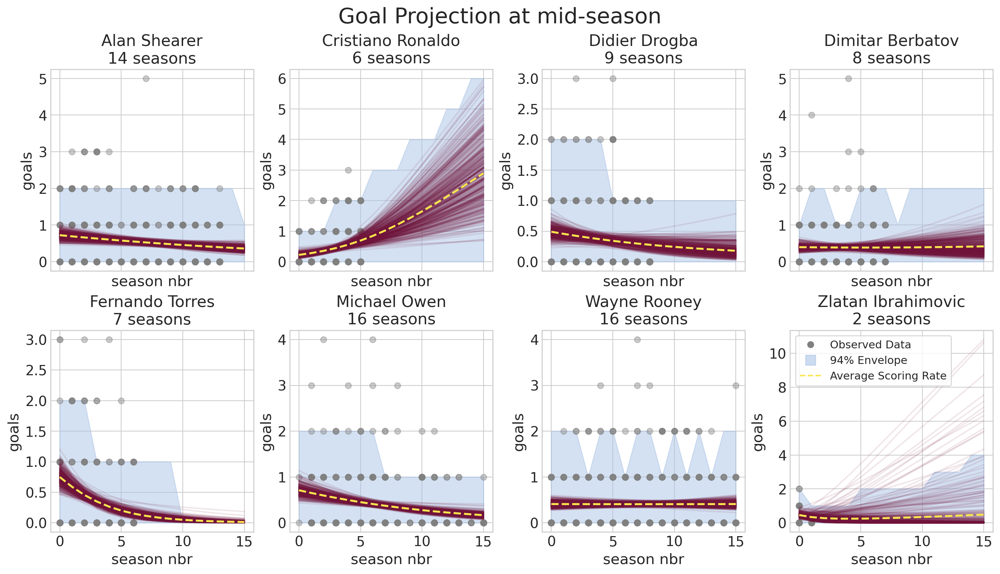

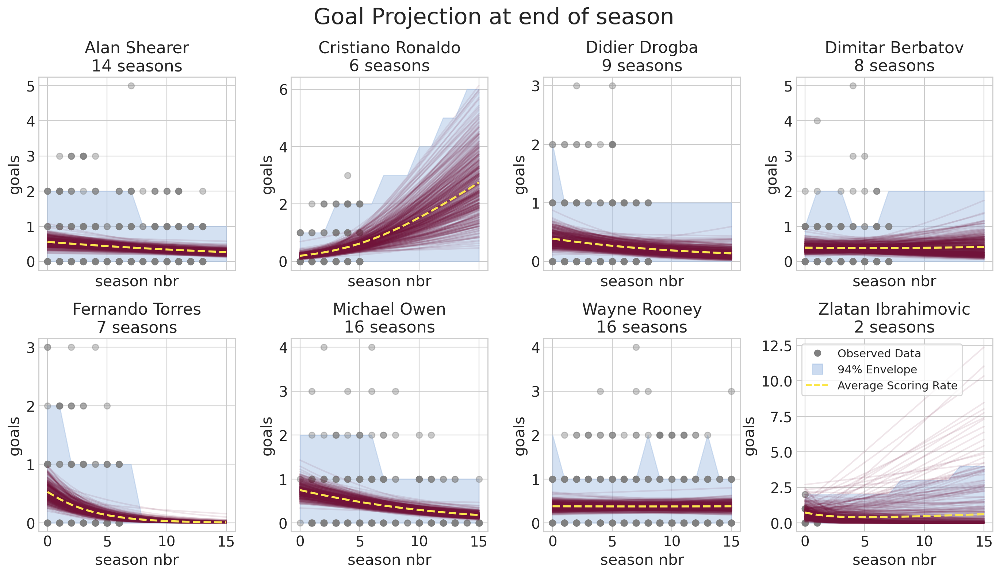

In [384]:
_, axes = plt.subplots(2, 4, figsize=(14, 8), sharex=True)
axes = axes.ravel()
seasons = data["season_nbr"].unique()
player_data = data.copy().set_index("name_player")

for ax, player in zip(axes, players):
    player_scoring_rate = az.extract(
        preds_start.predictions.sel(player=player), var_names="scoring_rate"
    ).sel(sample=slice(None, None, 10))
    player_preds = preds_start.predictions.sel(player=player)["goals_scored"]

    az.plot_hdi(seasons, player_preds, ax=ax, smooth=False, color="#AAC4E6")
    ax.scatter(
        player_data.loc[player, "season_nbr"],
        player_data.loc[player, "goals_in_match"],
        c="grey",
        alpha=0.4,
    )
    ax.plot(seasons, player_scoring_rate, color="#70133A", alpha=0.1)
    ax.plot(seasons, player_scoring_rate.mean("sample"), color="#FBE64D", lw=2, ls="--")

    ax.set(
        title=f"{player.title()}\n{n_seasons.loc[player]} seasons",
        xlabel="season nbr",
        ylabel="goals",
    )

handles = [
    Line2D([], [], color="grey", marker="o", linestyle="None", label="Observed Data"),
    Line2D(
        [],
        [],
        color="#AAC4E6",
        alpha=0.6,
        marker="s",
        markersize=10,
        linestyle="None",
        label="94% Envelope",
    ),
    Line2D([], [], color="#FBE64D", ls="--", label="Average Scoring Rate"),
]
ax.legend(handles=handles, fontsize=11, frameon=True)
plt.suptitle("Goal Projection at beginning of season", fontsize=22)

_, axes = plt.subplots(2, 4, figsize=(14, 8), sharex=True)
axes = axes.ravel()
seasons = data["season_nbr"].unique()
player_data = data.copy().set_index("name_player")

for ax, player in zip(axes, players):
    player_scoring_rate = az.extract(
        preds_mid.predictions.sel(player=player), var_names="scoring_rate"
    ).sel(sample=slice(None, None, 10))
    player_preds = preds_mid.predictions.sel(player=player)["goals_scored"]

    az.plot_hdi(seasons, player_preds, ax=ax, smooth=False, color="#AAC4E6")
    ax.scatter(
        player_data.loc[player, "season_nbr"],
        player_data.loc[player, "goals_in_match"],
        c="grey",
        alpha=0.4,
    )
    ax.plot(seasons, player_scoring_rate, color="#70133A", alpha=0.1)
    ax.plot(seasons, player_scoring_rate.mean("sample"), color="#FBE64D", lw=2, ls="--")

    ax.set(
        title=f"{player.title()}\n{n_seasons.loc[player]} seasons",
        xlabel="season nbr",
        ylabel="goals",
    )

ax.legend(handles=handles, fontsize=11, frameon=True)
plt.suptitle("Goal Projection at mid-season", fontsize=22)

_, axes = plt.subplots(2, 4, figsize=(14, 8), sharex=True)
axes = axes.ravel()
seasons = data["season_nbr"].unique()
player_data = data.copy().set_index("name_player")

for ax, player in zip(axes, players):
    player_scoring_rate = az.extract(
        preds_end.predictions.sel(player=player), var_names="scoring_rate"
    ).sel(sample=slice(None, None, 10))
    player_preds = preds_end.predictions.sel(player=player)["goals_scored"]

    az.plot_hdi(seasons, player_preds, ax=ax, smooth=False, color="#AAC4E6")
    ax.scatter(
        player_data.loc[player, "season_nbr"],
        player_data.loc[player, "goals_in_match"],
        c="grey",
        alpha=0.4,
    )
    ax.plot(seasons, player_scoring_rate, color="#70133A", alpha=0.1)
    ax.plot(seasons, player_scoring_rate.mean("sample"), color="#FBE64D", lw=2, ls="--")

    ax.set(
        title=f"{player.title()}\n{n_seasons.loc[player]} seasons",
        xlabel="season nbr",
        ylabel="goals",
    )

ax.legend(handles=handles, fontsize=11, frameon=True)
plt.suptitle("Goal Projection at end of season", fontsize=22)
plt.tight_layout();

## Excess-Skill Metric

Therefore, let's have alook at the **excess-skill-metric** $S_{i,s}$. It compares each player's probability of scoring ($\hat{p}_{i,s}$) when accounting for both his ability and his team's strength ($\hat{\alpha}_{i,s} + \mathbf{X}_{i,s} \, \hat{\beta}$) to the probability of him scoring when only accounting for his own skill/ability ($\hat{\alpha}_{i,s}$):

 $$ S_{i,s} = \frac{\frac{e^{\hat{\alpha}_{i,s}}}{1 \; + \; e^{\hat{\alpha}_{i,s}}}}{\frac{e^{\hat{\alpha}_{i,s} + \mathbf{X}_{i,s} \, \hat{\beta}}}{1 \; + \; e^{\hat{\alpha}_{i,s} + \mathbf{X}_{i,s} \, \hat{\beta}}}} \quad ,$$

where $S_{i,s} > 1$ tells us that -- according to the model -- **the player's scoring probability was dragged down by his team's performance**. Said differently, **player $i$'s full potential did not come through** while playing for that particular team in season $s$.


<br>

Since we already have stored the estimates for the numerator in `Player_Skill_season`, the only thing that is left to compute $S_{i,s}$ is the denominator.

To estimate the full model ( $\hat{\alpha}_{i,s} + \mathbf{X}_{i,s} \, \hat{\beta}$ ), we could again draw all our parameter-samples from the posterior via `trace_multi.posterior` and simulate some predictions ($\hat{p}_{i,s}$) using our observed factors $\mathbf{X}_{i,s}$. But that sounds like a lot of manual work ...

<br>

... **but with [#PyMC](https://www.pymc.io/welcome.html) it's pretty easy!** The `trace_multi.posterior["p_score"]` array has already got everything what we are looking for, namely the denominator in $S_{i,s}$.

<br>

Awesome! Let's compute our $S_{i,s}$ statistic as described above:

In [321]:
mindex_coords = xr.Coordinates.from_pandas_multiindex(
    data.set_index(["name_player", "season", "days_since_first_game"]).index, "obs_id"
)

idata.posterior = idata.posterior.assign_coords(mindex_coords)

In [337]:
perf_alone = np.logaddexp(0, idata.posterior["alpha"])  # equivalent to softplus(x)
perf_with_team = idata.posterior["scoring_rate"]
s_metric = perf_alone / perf_with_team

In [355]:
filtered_seasons = data.groupby("season")["name_player"].nunique().ge(3)
seasons_with_at_least_three_players = filtered_seasons[filtered_seasons].index

/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_45158/547001468.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout();


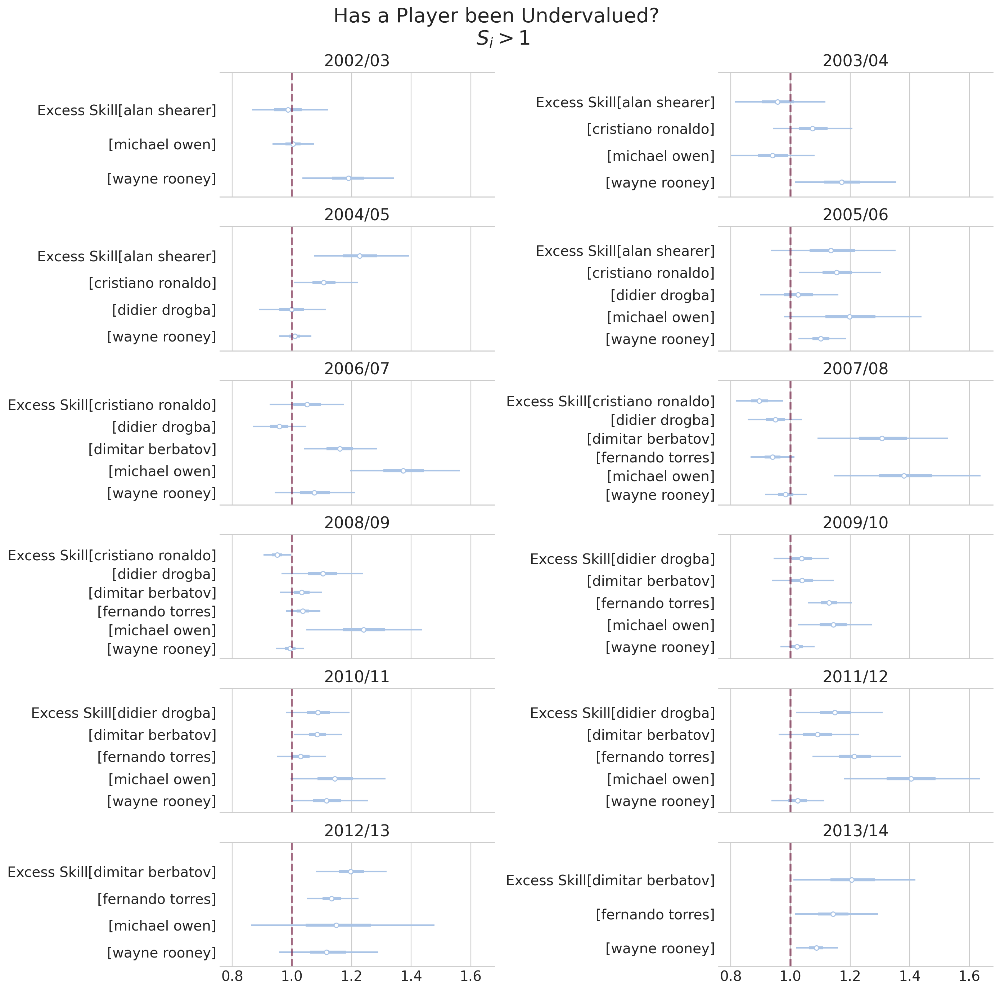

In [385]:
_, axes = plt.subplots(6, 2, figsize=(14, 14), sharex=True)
axes = axes.ravel()

for ax, season in zip(axes, seasons_with_at_least_three_players):
    s_per_season = (
        s_metric.sel(season=season).groupby("name_player").mean().rename("Excess Skill")
    )
    az.plot_forest(s_per_season, combined=True, ax=ax, colors="#AAC4E6")
    ax.set_title(season)
    ax.axvline(x=1, color="#70133A", alpha=0.6, ls="--", lw=2)

plt.suptitle("Has a Player been Undervalued? \n $S_{i} > 1$", fontsize=20)
plt.tight_layout();

In [62]:
# ========================================== A Player's EXCESS Skill/Ability ========================================== #

# --- As above, we will store the probabilities for each player 'by season' and 'across seasons'
Player_ProbScore_season = {key: [] for key in players}
Player_ProbScore = {key: [] for key in np.unique(data["name_player"])}


for pp in range(len(my_player)):

    # --- Get the range in the "likelihood-database" that gives you the predictions for player "i" in season "s"
    # --- --- Extract the seasons that the player has played
    season_s = pd.unique(MY_PLAYERS[my_player[pp]].season)

    if pp == 0:
        range_prev = 0
    else:
        range_prev = np.sum(
            [MY_PLAYERS[my_player[prev]].shape[0] for prev in range(pp)]
        )

    for ss in range(len(season_s)):

        index_ss = MY_PLAYERS[my_player[pp]].index[
            MY_PLAYERS[my_player[pp]].season == season_s[ss]
        ]

        # --- Get the range in the "likelihood-database" that gives you the predictions for player "i"
        range_start = range_prev + index_ss[0]
        range_end = range_prev + index_ss[-1]

        # pred_samples = ppc.posterior_predictive.data_vars["likelihood"][:,:,range(range_start,range_end)].values
        pred_samples = trace_multi.posterior["p_score"][
            :, :, range(range_start, range_end)
        ].values

        # --- Get the Mean
        mean = np.mean(pred_samples).flatten()

        # --- Get the Median --> can be used instead of the mean
        median = np.median(pred_samples).flatten()

        # --- --- Store the median probabilities by season
        pp_name = my_player[pp] + " " + season_s[ss]
        Player_ProbScore_season[pp_name] = mean

        # --- --- Store the median probabilities across seasons
        Player_ProbScore[my_player[pp]].append(mean)

<br>

So let's plot $S_{i,s}$, i.e. player $i$'s *excess-skill* in season $s$!

<br>

> Recall: $\,$ if $S_{i,s} > 1$ -- accordng to the model -- the player is *under-valued* compared to his inherent skill/ability, <br> &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&ensp; i.e. the player actually has **excess skill** but his own team is dragging him down.

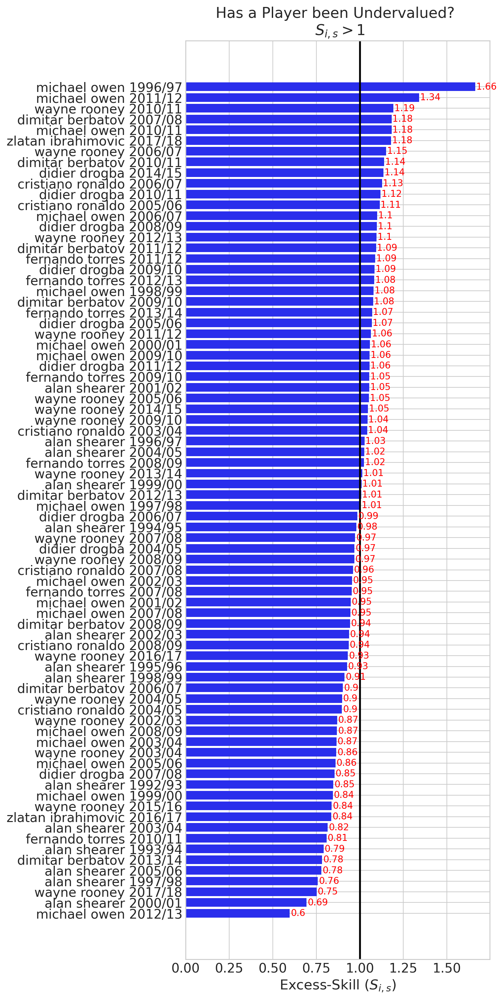

In [63]:
# --- Initialize the plotting-dataframe
plot_df = pd.DataFrame({"players": Player_ProbScore_season.keys()})

# --- Assemble the ability-/skill-statistics that you have alreday calculated previously
plot_df["S"] = [
    (Player_Skill_season[pp] / Player_ProbScore_season[pp])[0]
    for pp in plot_df["players"]
]

# --- Sort the dataframe descendingly according to 'S'
plot_df = plot_df.sort_values(by="S", ascending=False, ignore_index=1)

# --- Start plotting!
fig, ax = plt.subplots(1, 1, figsize=(7.5, 15))
ax.barh(np.arange(plot_df.shape[0]), plot_df["S"].values)
ax.axvline(x=1, color="black", lw=2)
ax.set_yticks(np.arange(plot_df.shape[0]))
ax.set_yticklabels(list(plot_df["players"]))
ax.invert_yaxis()
ax.set_title("Has a Player been Undervalued? \n $S_{i,s} > 1$")
ax.set_xlabel("Excess-Skill ($S_{i,s}$)")

# --- --- Attach the 'S' metric:
for i, _ in enumerate(plot_df["S"]):
    ax.text(
        plot_df.loc[i, "S"] + 0.005,
        i + 0.25,
        str(np.round(plot_df.loc[i, "S"], 2)),
        color="red",
    )

<br>

But it could also be interesting to look **across seasons**! <br>
Let's just apply a summary metric (naturally the *mean* or *median*) on $S_{i,s}$ (where $S_{i,s}$ itself is either the *mean* or *median* of samples from the posterior distribution) across $s$, and get $S_{i}$, i.e. player $i$'s *excess-skill* across all seasons $s$.

In [333]:
s_across_seasons = s_metric.groupby("name_player").mean().rename("Excess Skill")

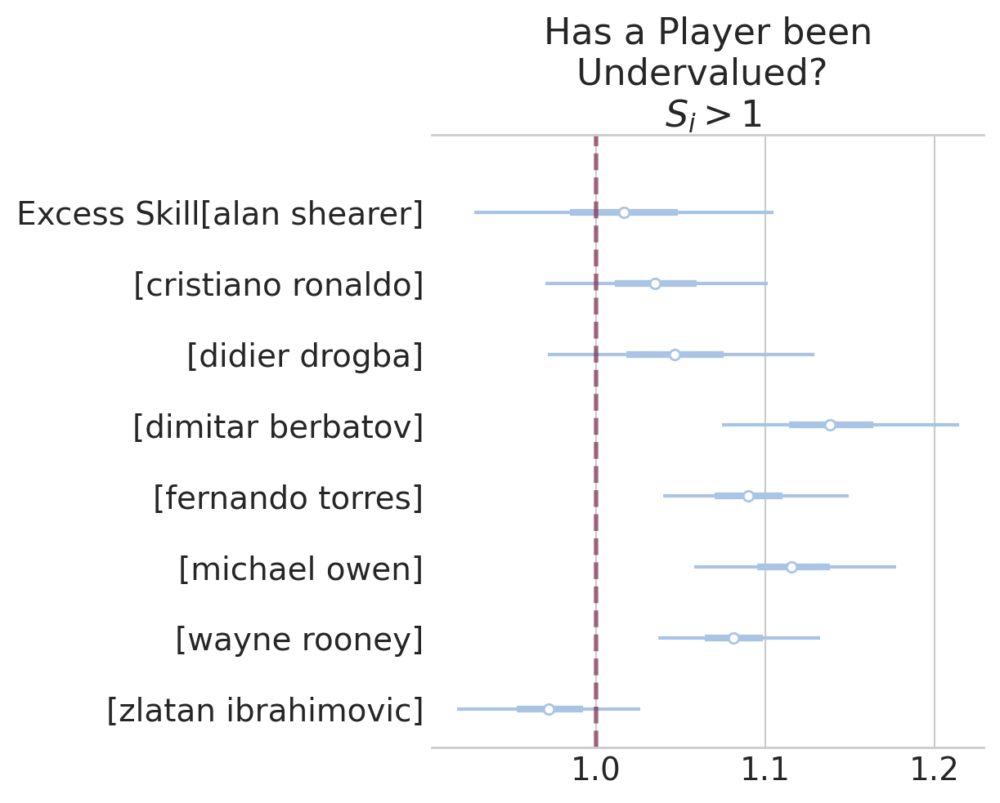

In [388]:
ax = az.plot_forest(s_across_seasons, combined=True, colors="#AAC4E6")
ax[0].set_title("Has a Player been Undervalued? \n $S_{i} > 1$")
ax[0].axvline(x=1, color="#70133A", alpha=0.6, ls="--", lw=2);

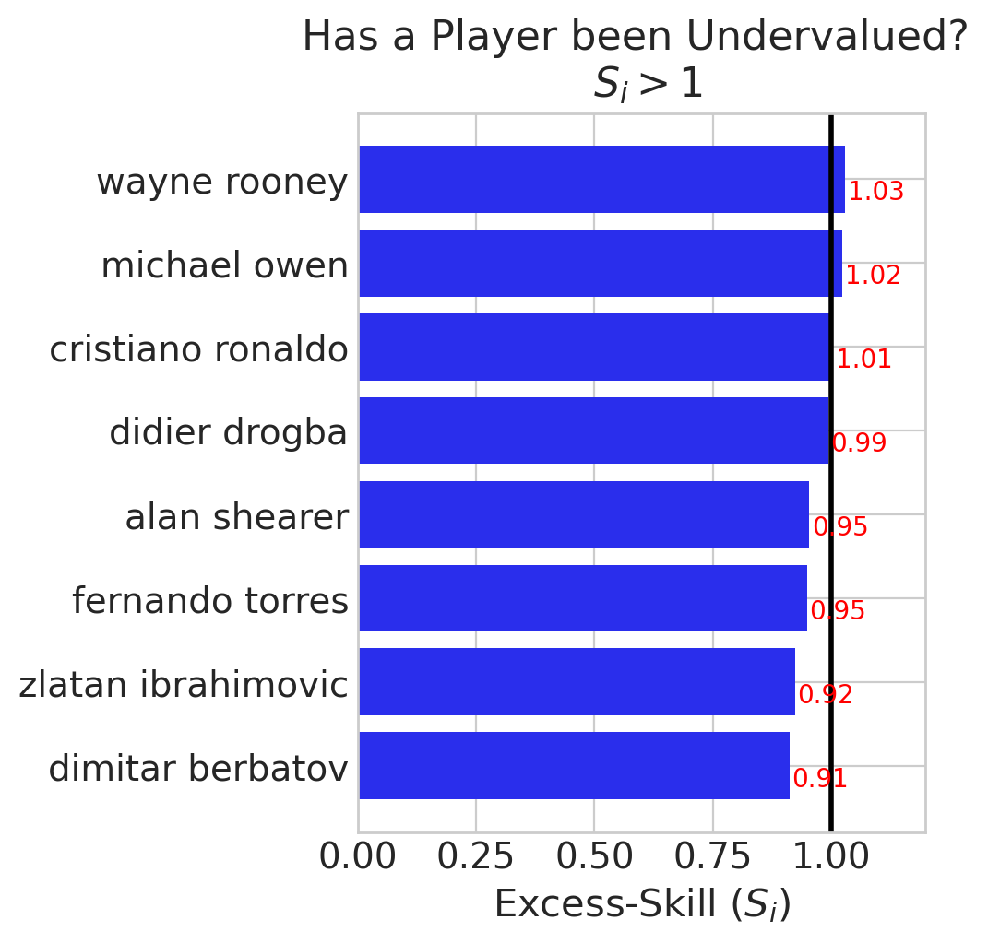

In [68]:
# --- Set up the data frame for plotting
plot_df = pd.DataFrame({"players": Player_ProbScore.keys()})
# --- Calculate "S": use either 'mean' or 'median'
plot_df["S"] = [
    np.median(Player_Skill[pp]) / np.median(Player_ProbScore[pp])
    for pp in plot_df["players"]
]
# --- Sort the dataframe descendingly according to 'S'
plot_df = plot_df.sort_values(by="S", ascending=False, ignore_index=1)


# --- Plot the results
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.barh(np.arange(plot_df.shape[0]), plot_df["S"].values)
ax.axvline(x=1, color="black", lw=2)
ax.set_yticks(np.arange(plot_df.shape[0]))
ax.set_yticklabels(list(plot_df["players"]))
ax.invert_yaxis()
ax.set_xlim(0, 1.2)
ax.set_title("Has a Player been Undervalued? \n $S_{i} > 1$")
ax.set_xlabel("Excess-Skill ($S_{i}$)")

# --- --- Attach the 'S' metric:
for i, _ in enumerate(plot_df["S"]):
    ax.text(
        plot_df.loc[i, "S"] + 0.005,
        i + 0.25,
        str(np.round(plot_df.loc[i, "S"], 2)),
        color="red",
    )

To recap again: the purpose of $S_{i}$ or $S_{i,s}$ is to evaluate how a  player's probability of scoring only based on his skill/ability, $\; P\left(Y_{i,s} | \hat{\alpha}_i \right) \;$, compares to the probability of him scoring when we also account for his team's strength, $\; P\left(Y_{i,s} | \mathbf{X}_{i,s}\, , \hat{\alpha}_i \, , \hat{\beta} \right) \;$. <br>
Keep in mind that we have built these metrics based on the posterior distribution's *median* (or the *mean*) -- hence, a single point-estimate only. We haven't said anything about the uncertainty around that single number.

## PAR computation

In [15]:
RLPs = pd.Index(
    [
        "harry kewell",
        "jermain defoe",
        "nicolas anelka",
        "robbie fowler",
        "robbie keane",
        "robert pires",
    ],
).sort_values()

factors = [
    "goalsscored_rank_team",
    "goalsscored_rank_team_wo_player",
    "home_pitch",
    "goalsconceded_rank_opp",
    "points_diff",
    "goal_balance_diff",
]

In [16]:
complete_data = pd.read_csv("../../10_data/101_SFM/SFM_data.csv")

complete_data["kickoff_dt"] = pd.to_datetime(
    complete_data["kickoff_dt"], yearfirst=True
)

# compute season number for each player, ~maturity of player
complete_data["season_nbr"] = complete_data.groupby(["name_player"])[
    "season"
].transform(lambda x: x.factorize(sort=True)[0])

# compute days since first game of the season for each player
# aka within-season effects
complete_data["days_since_first_game"] = complete_data.groupby(
    ["name_player", "season"]
)["kickoff_dt"].transform(lambda x: (x - x.min()).dt.days)

complete_data["goals_in_match"] = complete_data["goals_in_match"].astype(int)
complete_data = complete_data.sort_values(["name_player", "kickoff_dt"]).reset_index(
    drop=True
)
complete_data["is_rlp"] = complete_data.name_player.isin(RLPs).astype(int)
players = pd.factorize(complete_data["name_player"], sort=True)[1]

complete_data

,goal,goals_in_match,points_team,points_opp,goalsscored_cum_team,goalsscored_cum_opp,goalsconceded_cum_team,goalsconceded_cum_opp,home_pitch,goalsscored_rank_team,...,goalsscored_diff,goal_balance_team,goal_balance_opp,goal_balance_diff,points_diff,goalsscored_share_player_team,name_player,season_nbr,days_since_first_game,is_rlp
0,1.0,2,11.0,3.0,7.0,5.0,3.0,12.0,1.0,13.0,...,2.0,4.0,-7.0,11.0,8.0,0.571429,alan shearer,0,0,0
1,0.0,0,14.0,10.0,11.0,10.0,4.0,9.0,0.0,5.0,...,1.0,7.0,1.0,6.0,4.0,0.545455,alan shearer,0,7,0
2,1.0,2,17.0,9.0,12.0,7.0,4.0,6.0,1.0,5.0,...,5.0,8.0,1.0,7.0,8.0,0.500000,alan shearer,0,10,0
3,1.0,1,17.0,5.0,14.0,8.0,7.0,12.0,0.0,2.0,...,6.0,7.0,-4.0,11.0,12.0,0.571429,alan shearer,0,14,0
4,1.0,1,18.0,11.0,15.0,18.0,8.0,17.0,1.0,4.0,...,-3.0,7.0,1.0,6.0,7.0,0.600000,alan shearer,0,21,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4458,0.0,0,35.0,43.0,35.0,46.0,9.0,10.0,1.0,1.0,...,-11.0,26.0,36.0,-10.0,-8.0,0.000000,zlatan ibrahimovic,1,21,0
4459,0.0,0,35.0,16.0,36.0,15.0,11.0,19.0,1.0,1.0,...,21.0,25.0,-4.0,29.0,19.0,0.000000,zlatan ibrahimovic,1,25,0
4460,0.0,0,38.0,14.0,37.0,12.0,11.0,22.0,0.0,1.0,...,25.0,26.0,-10.0,36.0,24.0,0.000000,zlatan ibrahimovic,1,28,0
4461,0.0,0,41.0,26.0,39.0,27.0,12.0,26.0,0.0,2.0,...,12.0,27.0,1.0,26.0,15.0,0.000000,zlatan ibrahimovic,1,35,0


In [17]:
factors_train = complete_data[factors].astype(float)
days_train = complete_data["days_since_first_game"]

# --- --- Mean & SD of 'data'
factors_mean = factors_train.mean(axis=0)
factors_sd = factors_train.std(axis=0)

days_mean = days_train.mean()
days_sd = days_train.std()

# ---- --- Standardize 'data'
factors_sdz = (factors_train - factors_mean) / factors_sd
days_sdz = (days_train - days_mean) / days_sd

In [18]:
coords = {
    "elite": players.difference(RLPs),
    "rlp": RLPs,
    "factor": my_vars,
    "obs_id": complete_data.index,
    "param": ["baseline_rlp", "maturity_effect_rlp", "within_season_effect_rlp"],
}
players_ordered = players.difference(RLPs).append(RLPs)
player_idx = pd.Categorical(
    complete_data["name_player"], categories=players_ordered
).codes

In [594]:
with pm.Model(coords=coords) as SFM_rlp:

    # Data containers
    seasons = pm.Data("seasons", complete_data["season_nbr"].to_numpy(), dims="obs_id")
    days = pm.Data("days", days_sdz.to_numpy(), dims="obs_id")
    player_id = pm.Data("player_id", player_idx, dims="obs_id")
    factor_data = pm.Data(
        "factor_data", factors_sdz.to_numpy(), dims=("obs_id", "factor")
    )
    goals_obs = pm.Data(
        "goals_obs", complete_data["goals_in_match"].to_numpy(), dims="obs_id"
    )

    # player skills
    ## elite players, unpooled
    baseline_elite = pm.Normal("baseline_elite", mu=0, sigma=0.5, dims="elite")
    maturity_effect_elite = pm.Normal(
        "maturity_effect_elite", mu=0, sigma=0.25, dims="elite"
    )
    within_season_effect_elite = pm.Normal(
        "within_season_effect_elite", mu=0, sigma=0.25, dims="elite"
    )

    ## RL players, partially-pooled
    # diversity = pm.TruncatedNormal("diversity", mu=1, sigma=0.25, lower=0, dims="param")
    diversity = pm.Gamma("diversity", 2, 2, dims="param")

    mu = pm.Normal("baseline_rlp_mean", mu=0, sigma=0.5)
    baseline_rlp = mu + diversity[0] * pm.Normal("baseline_rlp_offset", dims="rlp")

    mu = pm.Normal("maturity_effect_rlp_mean", mu=0, sigma=0.25)
    maturity_effect_rlp = mu + diversity[1] * pm.Normal(
        "maturity_effect_rlp_offset", dims="rlp"
    )

    mu = pm.Normal("within_season_effect_rlp_mean", mu=0, sigma=0.25)
    within_season_effect_rlp = mu + diversity[2] * pm.Normal(
        "within_season_effect_rlp_offset", dims="rlp"
    )

    ## concatenate levels
    baseline = pt.concatenate([baseline_elite, baseline_rlp])
    maturity_effect = pt.concatenate([maturity_effect_elite, maturity_effect_rlp])
    within_season_effect = pt.concatenate(
        [within_season_effect_elite, within_season_effect_rlp]
    )

    ## regression for player skills
    alpha = pm.Deterministic(
        "alpha",
        baseline[player_id]
        + maturity_effect[player_id] * seasons
        + within_season_effect[player_id] * days,
        dims="obs_id",
    )

    # team factors
    beta = pm.Normal("beta", mu=0, sigma=0.25, dims="factor")

    # --- Probability of Scoring
    scoring_rate = pm.Deterministic(
        "scoring_rate",
        pt.softplus(alpha + pm.math.dot(factor_data, beta)),
        dims="obs_id",
    )
    # scoring_rate = pt.softplus(alpha + pm.math.dot(factor_data, beta))
    # just because Truncated doesn't want Deterministics
    # _ = pm.Deterministic('scoring_rate', scoring_rate, dims="obs_id")

    pm.Poisson("goals_scored", scoring_rate, observed=goals_obs, dims="obs_id")
    # pm.Truncated("goals_scored", pm.Poisson.dist(scoring_rate), lower=None, upper=45, observed=goals_obs, dims="obs_id")

    idata = pm.sample_prior_predictive()

Sampling: [baseline_elite, baseline_rlp_mean, baseline_rlp_offset, beta, diversity, goals_scored, maturity_effect_elite, maturity_effect_rlp_mean, maturity_effect_rlp_offset, within_season_effect_elite, within_season_effect_rlp_mean, within_season_effect_rlp_offset]


In [155]:
with pm.Model(coords=coords) as SFM_rlp:

    # Data containers
    seasons = pm.Data("seasons", complete_data["season_nbr"].to_numpy(), dims="obs_id")
    days = pm.Data("days", days_sdz.to_numpy(), dims="obs_id")
    player_id = pm.Data("player_id", player_idx, dims="obs_id")
    factor_data = pm.Data(
        "factor_data", factors_sdz.to_numpy(), dims=("obs_id", "factor")
    )
    goals_obs = pm.Data(
        "goals_obs", complete_data["goals_in_match"].to_numpy(), dims="obs_id"
    )

    # player skills
    ## elite players, unpooled
    baseline_elite = pm.Normal("baseline_elite", mu=0, sigma=1, dims="elite")
    maturity_effect_elite = pm.Normal(
        "maturity_effect_elite", mu=0, sigma=0.5, dims="elite"
    )
    within_season_effect_elite = pm.Normal(
        "within_season_effect_elite", mu=0, sigma=0.5, dims="elite"
    )

    ## RL players, partially-pooled
    diversity = pm.TruncatedNormal(
        "diversity", mu=0.5, sigma=0.3, lower=0, dims="param"
    )

    mu = pm.Normal("baseline_rlp_mean", mu=0, sigma=1)
    baseline_rlp = mu + diversity[0] * pm.ZeroSumNormal(
        "baseline_rlp_offset", dims="rlp"
    )

    mu = pm.Normal("maturity_effect_rlp_mean", mu=0, sigma=0.5)
    maturity_effect_rlp = mu + diversity[1] * pm.ZeroSumNormal(
        "maturity_effect_rlp_offset", dims="rlp"
    )

    mu = pm.Normal("within_season_effect_rlp_mean", mu=0, sigma=0.5)
    within_season_effect_rlp = mu + diversity[2] * pm.ZeroSumNormal(
        "within_season_effect_rlp_offset", dims="rlp"
    )

    ## concatenate levels
    baseline = pt.concatenate([baseline_elite, baseline_rlp])
    maturity_effect = pt.concatenate([maturity_effect_elite, maturity_effect_rlp])
    within_season_effect = pt.concatenate(
        [within_season_effect_elite, within_season_effect_rlp]
    )

    ## regression for player skills
    alpha = pm.Deterministic(
        "alpha",
        baseline[player_id]
        + maturity_effect[player_id] * seasons
        + within_season_effect[player_id] * days,
        dims="obs_id",
    )

    # team factors
    beta = pm.Normal("beta", mu=0, sigma=0.5, dims="factor")

    # --- Probability of Scoring
    scoring_rate = pt.softplus(alpha + pm.math.dot(factor_data, beta))
    concentration = pm.Exponential("concentration", scale=2)

    dist = pm.NegativeBinomial.dist(
        mu=scoring_rate,
        alpha=concentration,
    )
    pm.Truncated(
        "goals_scored",
        dist,
        lower=None,
        upper=goals_obs.max() + 1,
        observed=goals_obs,
        dims="obs_id",
    )

    idata = pm.sample_prior_predictive()

Sampling: [baseline_elite, baseline_rlp_mean, baseline_rlp_offset, beta, concentration, diversity, goals_scored, maturity_effect_elite, maturity_effect_rlp_mean, maturity_effect_rlp_offset, within_season_effect_elite, within_season_effect_rlp_mean, within_season_effect_rlp_offset]


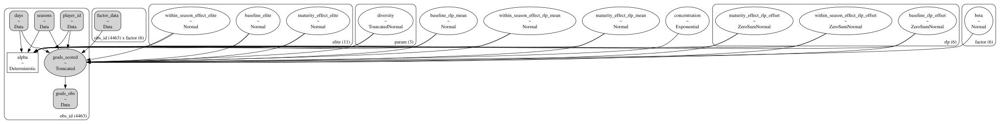

In [141]:
pm.model_to_graphviz(SFM_rlp)

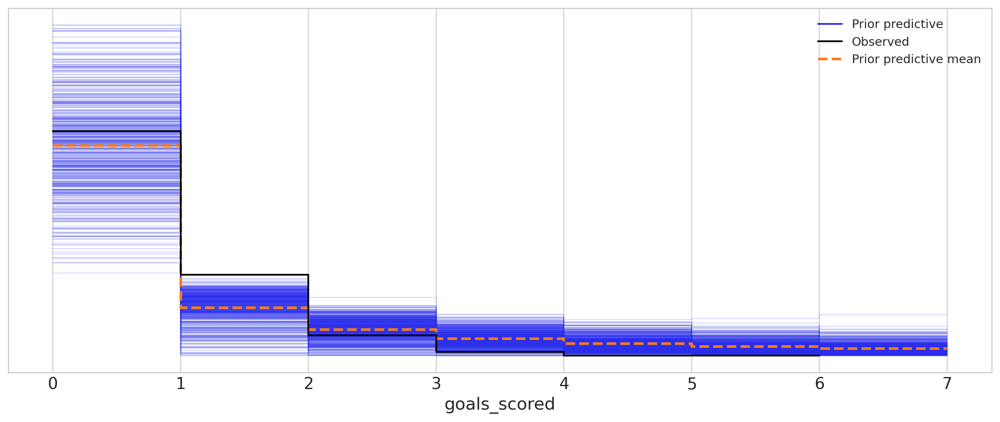

In [156]:
az.plot_ppc(idata, group="prior", observed=True);

In [157]:
with SFM_rlp:
    idata.extend(pm.sample(target_accept=0.95))
    idata.extend(pm.sample_posterior_predictive(idata))

/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.11/site-packages/pytensor/tensor/rewriting/elemwise.py:702: UserWarning: Optimization Warning: The Op betainc does not provide a C implementation. As well as being potentially slow, this also disables loop fusion.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.11/site-packages/pytensor/tensor/rewriting/elemwise.py:702: UserWarning: Optimization Warning: The Op betainc does not provide a C implementation. As well as being potentially slow, this also disables loop fusion.
  warn(
/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.11/site-packages/pytensor/tensor/rewriting/elemwise.py:702: UserWarning: Optimization Warning: The Op betainc does not provide a C implementation. As well as being potentially slow, this also disables loop fusion.
  warn(
/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.11

Output()

/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.11/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 274 seconds.
There were 1 divergences after tuning. Increase `target_accept` or reparameterize.
Sampling: [goals_scored]


Output()

In [163]:
az.ess(idata).min().to_pandas().sort_values().round()

diversity                          1009.0
alpha                              2091.0
maturity_effect_rlp_mean           2259.0
baseline_rlp_offset                2787.0
baseline_rlp_mean                  2933.0
baseline_elite                     3015.0
maturity_effect_rlp_offset         3089.0
maturity_effect_elite              3163.0
beta                               3366.0
within_season_effect_rlp_offset    3690.0
concentration                      4744.0
within_season_effect_elite         4806.0
within_season_effect_rlp_mean      5217.0
dtype: float64

In [164]:
az.summary(
    idata,
    var_names=["~alpha", "~scoring_rate", "~_log__"],
    filter_vars="regex",
    round_to=2,
)

/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.11/site-packages/arviz/utils.py:142: UserWarning: Items starting with ~: ['scoring_rate', '_log__'] have not been found and will be ignored
  warnings.warn(


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_elite[alan shearer],0.01,0.19,-0.35,0.36,0.00,0.00,3014.97,3035.74,1.0
baseline_elite[cristiano ronaldo],-1.39,0.32,-1.99,-0.81,0.01,0.00,3619.29,3187.02,1.0
baseline_elite[didier drogba],-0.41,0.24,-0.86,0.06,0.00,0.00,3490.84,2964.31,1.0
baseline_elite[dimitar berbatov],-0.77,0.24,-1.23,-0.35,0.00,0.00,4256.39,2989.03,1.0
baseline_elite[fernando torres],0.07,0.26,-0.43,0.54,0.00,0.00,3689.25,2930.21,1.0
...,...,...,...,...,...,...,...,...,...
within_season_effect_rlp_offset[jermain defoe],0.06,0.71,-1.36,1.43,0.01,0.01,4310.00,2264.02,1.0
within_season_effect_rlp_offset[nicolas anelka],0.13,0.72,-1.21,1.55,0.01,0.01,4386.04,2732.05,1.0
within_season_effect_rlp_offset[robbie fowler],-0.40,0.75,-1.84,1.04,0.01,0.01,3690.07,2707.76,1.0
within_season_effect_rlp_offset[robbie keane],0.18,0.73,-1.18,1.64,0.01,0.01,4914.48,2589.09,1.0


/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.11/site-packages/arviz/utils.py:142: UserWarning: Items starting with ~: ['scoring_rate', '_log__'] have not been found and will be ignored
  warnings.warn(


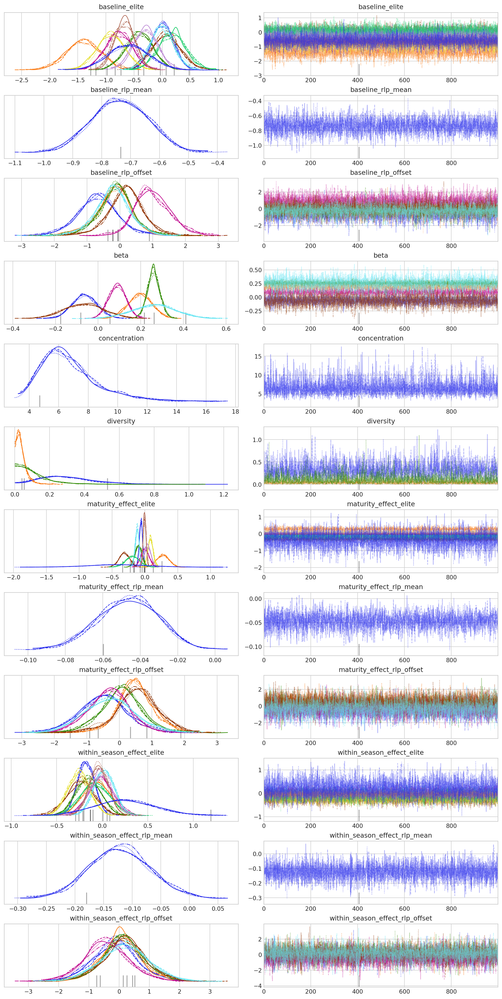

In [165]:
az.plot_trace(
    idata, var_names=["~alpha", "~scoring_rate", "~_log__"], filter_vars="regex"
);

In [166]:
az.plot_dist_comparison(
    idata,
    var_names=[
        "beta",
        "concentration",
        "diversity",
        "baseline_rlp_mean",
        "maturity_effect_rlp_mean",
        "within_season_effect_rlp_mean",
    ],
);

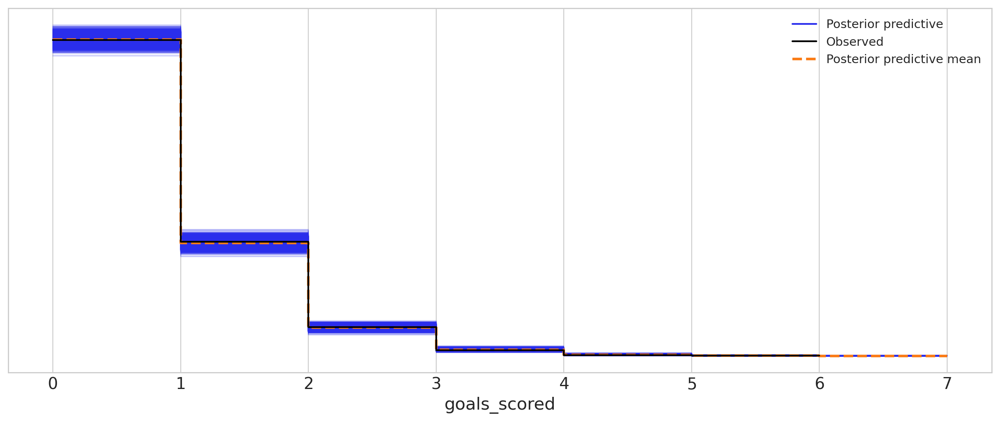

In [167]:
az.plot_ppc(idata);

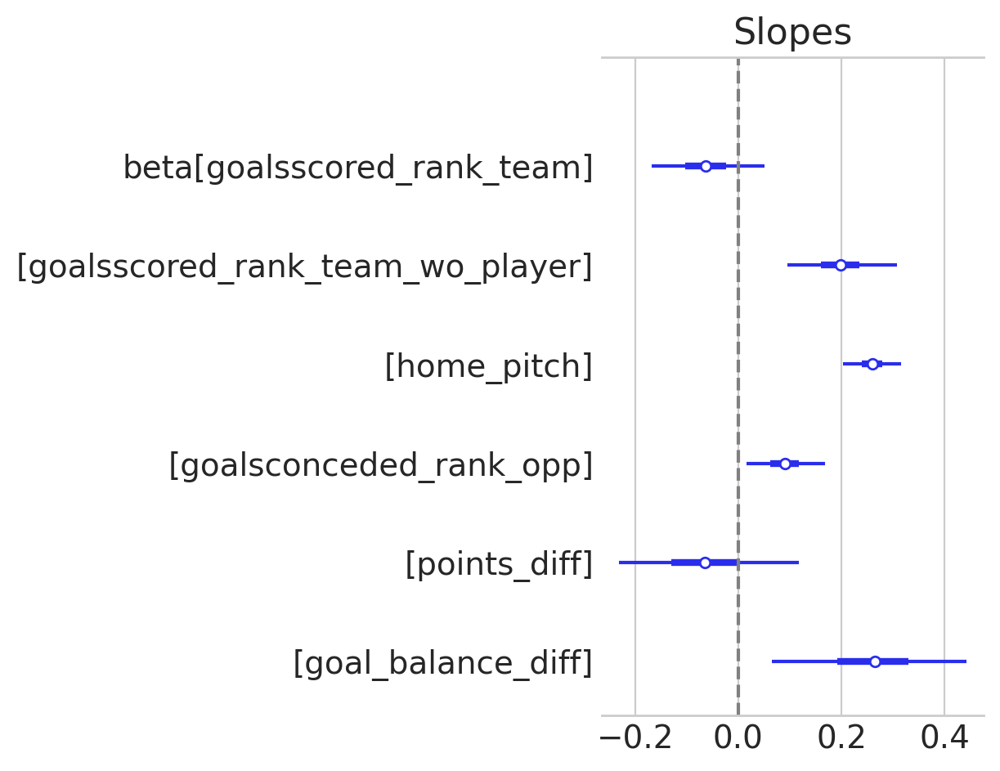

In [168]:
ax = az.plot_forest(idata, var_names="beta", combined=True)
ax[0].axvline(c="grey", ls="--")
ax[0].set(title="Slopes");

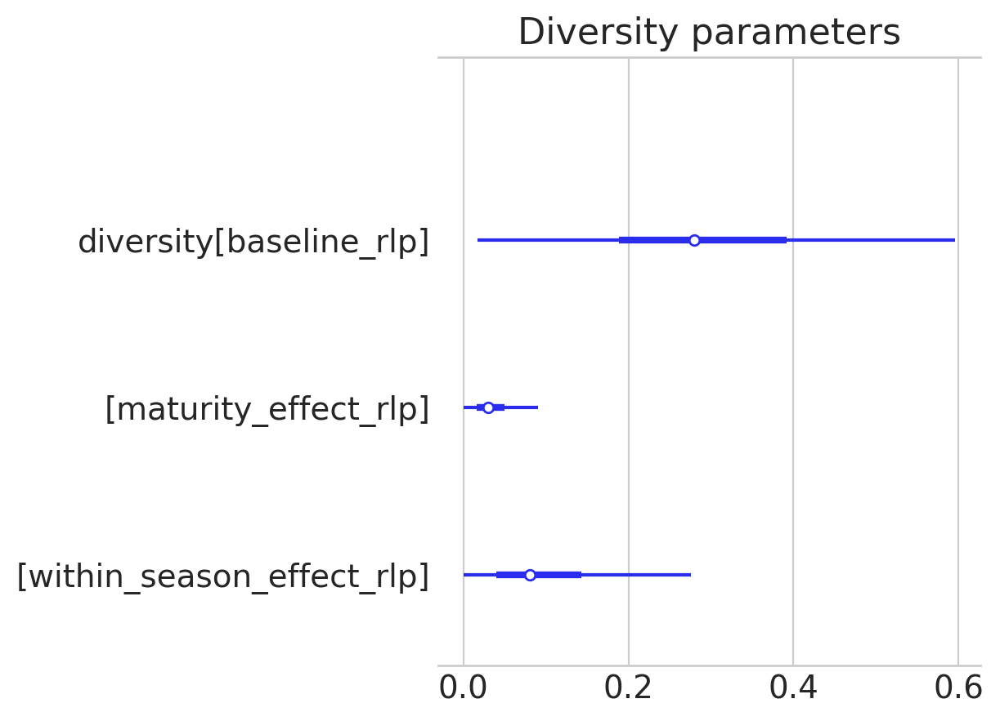

In [169]:
ax = az.plot_forest(idata, var_names="diversity", combined=True)
ax[0].set(title="Diversity parameters");

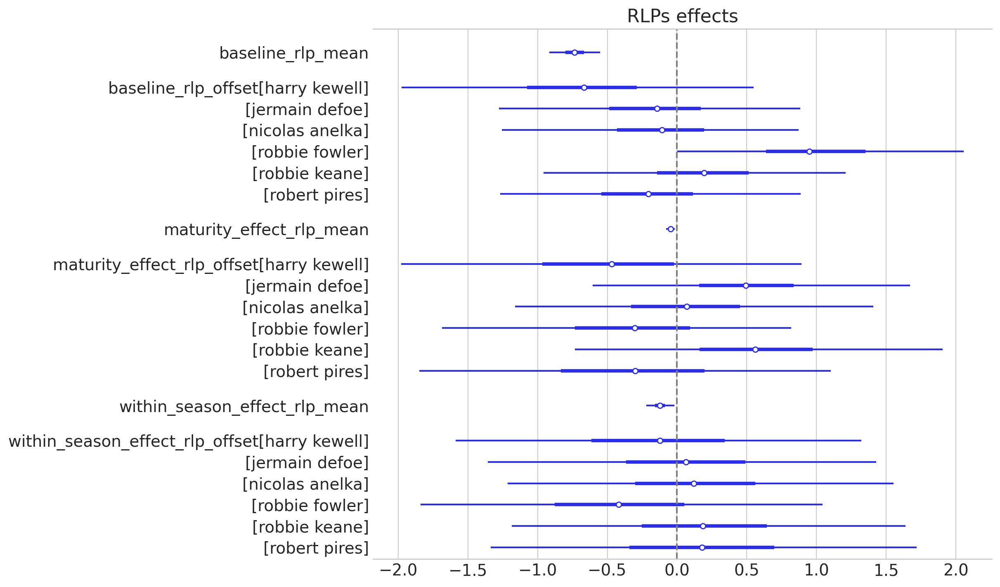

In [170]:
ax = az.plot_forest(
    idata, var_names="_rlp", filter_vars="regex", combined=True, figsize=(12, 7)
)
ax[0].axvline(c="grey", ls="--")
ax[0].set(title="RLPs effects");

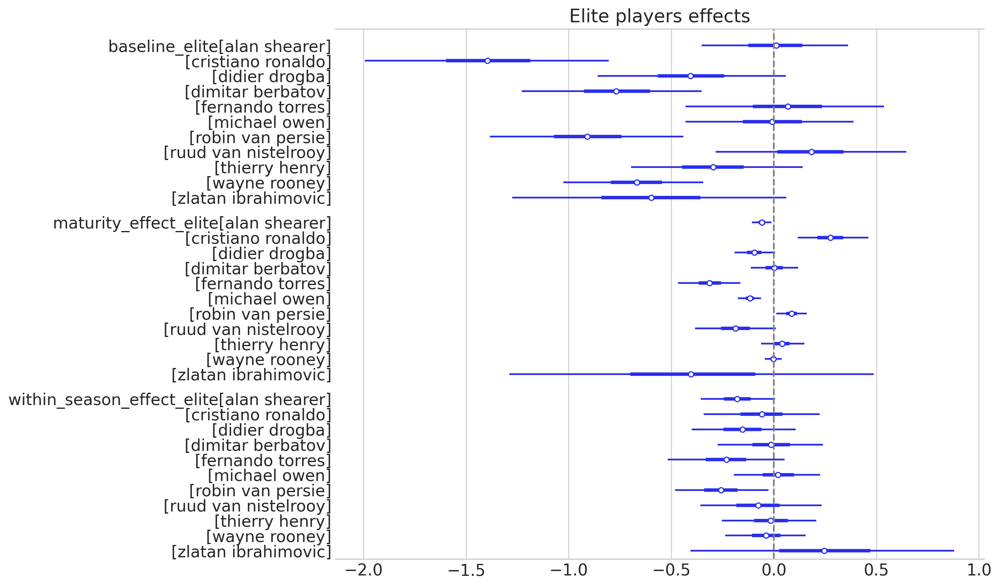

In [171]:
ax = az.plot_forest(
    idata, var_names="_elite", filter_vars="regex", combined=True, figsize=(12, 7)
)
ax[0].axvline(c="grey", ls="--")
ax[0].set(title="Elite players effects");

In [158]:
mindex_coords = xr.Coordinates.from_pandas_multiindex(
    complete_data.set_index(["name_player", "season", "days_since_first_game"]).index,
    "obs_id",
)

idata.posterior = idata.posterior.assign_coords(mindex_coords)
idata.posterior_predictive = idata.posterior_predictive.assign_coords(mindex_coords)

In [159]:
with pm.Model(coords=coords) as synthetic_player:
    player_id_new = pt.random.choice(len(RLPs))

    alpha_new = (
        baseline_rlp[player_id_new]
        + maturity_effect_rlp[player_id_new] * seasons
        + within_season_effect_rlp[player_id_new] * days
    )

    scoring_rate_new = pt.softplus(alpha_new + pm.math.dot(factor_data, beta))

    dist_new = pm.NegativeBinomial.dist(
        mu=scoring_rate_new,
        alpha=concentration,
    )
    pm.Truncated(
        "goals_scored_new",
        dist_new,
        lower=None,
        upper=goals_obs.max() + 1,
        dims="obs_id",
    )

    rlp_preds = pm.sample_posterior_predictive(
        idata, var_names=["goals_scored_new"], random_seed=rng
    )

Sampling: [goals_scored_new]


Output()

In [160]:
rlp_preds.posterior_predictive = rlp_preds.posterior_predictive.assign_coords(
    mindex_coords
)

elite_players = idata.posterior_predictive["goals_scored"]
rl_players = rlp_preds.posterior_predictive["goals_scored_new"]

par = (elite_players - rl_players).rename("PAR").reset_index("obs_id")
elite_par = par.where(par["name_player"].isin(coords["elite"]), drop=True)
rlp_par = par.where(par["name_player"].isin(coords["rlp"]), drop=True)

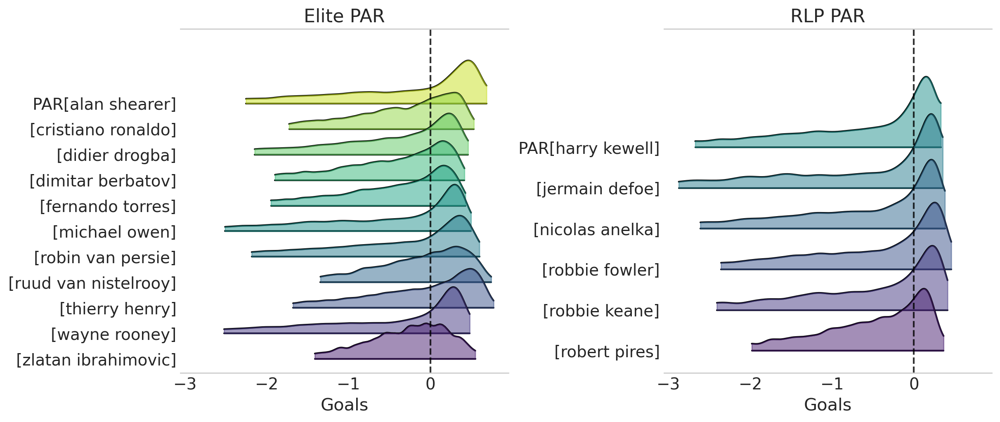

In [161]:
_, (left, right) = plt.subplots(1, 2, sharex=True)

az.plot_forest(
    elite_par.groupby("name_player").mean("obs_id"),
    combined=True,
    kind="ridgeplot",
    ridgeplot_overlap=1.5,
    ridgeplot_alpha=0.5,
    ax=left,
)

colors = sns.color_palette("viridis", n_colors=len(coords["elite"]))
# adjust colors manually
for patch, color in zip(left.collections, colors):
    patch.set_color(color)

left.axvline(c="k", ls="--", alpha=0.8)
left.set(title="Elite PAR", xlabel="Goals")

az.plot_forest(
    rlp_par.groupby("name_player").mean("obs_id"),
    combined=True,
    kind="ridgeplot",
    ridgeplot_overlap=1.5,
    ridgeplot_alpha=0.5,
    ax=right,
)

for patch, color in zip(right.collections, colors):
    patch.set_color(color)

right.axvline(c="k", ls="--", alpha=0.8)
right.set(title="RLP PAR", xlabel="Goals");

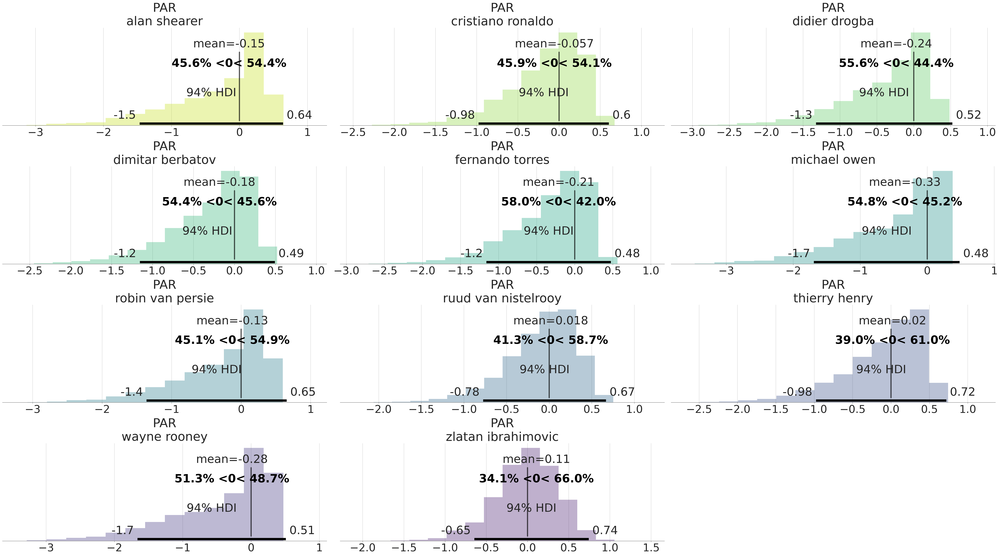

In [80]:
axes = az.plot_posterior(
    elite_par.groupby("name_player").mean("obs_id"),
    kind="hist",
    grid=(4, 3),
    textsize=32,
    ref_val=0,
    ref_val_color="k",
)

# customize bar colors
for ax, color in zip(axes.flatten(), colors[::-1]):
    for bar in ax.patches:
        bar.set_facecolor(color)

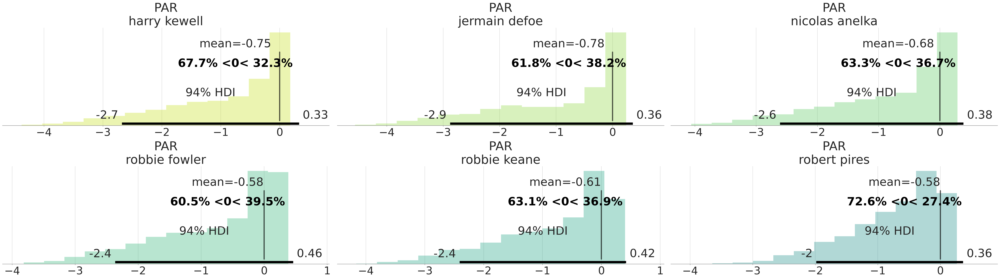

In [162]:
axes = az.plot_posterior(
    rlp_par.groupby("name_player").mean("obs_id"),
    kind="hist",
    grid=(2, 3),
    textsize=32,
    ref_val=0,
    ref_val_color="k",
)

# customize bar colors
for ax, color in zip(axes.flatten(), colors[::-1]):
    for bar in ax.patches:
        bar.set_facecolor(color)

In [58]:
%load_ext watermark
%watermark -n -u -v -iv -w

Last updated: Sun May 19 2024

Python implementation: CPython
Python version       : 3.11.9
IPython version      : 8.22.2

numpy     : 1.26.4
pandas    : 2.2.2
arviz     : 0.18.0
pytensor  : 2.20.0
xarray    : 2024.3.0
matplotlib: 3.8.4
seaborn   : 0.13.2
pymc      : 5.15.0

Watermark: 2.4.3

